In [ ]:
# !pip install ai-edge-litert
# !pip install tflite-support-nightly

  Using cached tflite_support_nightly-0.4.4.dev20230716-cp310-cp310-manylinux2014_x86_64.whl.metadata (2.4 kB)
Using cached tflite_support_nightly-0.4.4.dev20230716-cp310-cp310-manylinux2014_x86_64.whl (60.8 MB)


In [ ]:
#!pip uninstall -y tflite-support-nightly
#!pip uninstall -y tflite-support

Found existing installation: tflite-support 0.4.4
Uninstalling tflite-support-0.4.4:
  Successfully uninstalled tflite-support-0.4.4


In [1]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.applications import MobileNetV3Small
from tensorflow.keras.applications.mobilenet_v3 import preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
from keras.preprocessing.image import load_img, img_to_array
# from google.colab.patches import cv2_imshow
import seaborn as sns
import os
# from ai_edge_litert.interpreter import Interpreter
# from tflite_support.metadata_writers import image_classifier
# from tflite_support.metadata_writers import writer_utils
print(tf.__version__)
# Cek apakah TensorFlow mendeteksi GPU
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print("TensorFlow menggunakan GPU:")
    for gpu in gpus:
        print(f"  - {gpu}")
else:
    print("TensorFlow tidak mendeteksi GPU.")

2024-12-10 09:43:57.621684: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1733798637.709349   88274 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1733798637.734004   88274 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-10 09:43:57.949916: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


2.18.0
TensorFlow menggunakan GPU:
  - PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [2]:
# Path ke direktori dataset
train_dir = '../datasets/datasets/train_all'
test_dir = '../datasets/datasets/test_all'

In [3]:
seed_init = 42
IMAGE_SIZE = (224, 224)

# Define data augmentation
data_augmentation = tf.keras.Sequential([
    # layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
    layers.RandomContrast(0.2),
    layers.RandomTranslation(0.1, 0.1),
    layers.RandomBrightness(0.2),
])

train_dataset = tf.keras.utils.image_dataset_from_directory(
    seed = seed_init,
    directory= train_dir,
    batch_size= 32,
    image_size= IMAGE_SIZE,
    shuffle = True,
    subset = 'training',
    validation_split = 0.2,
    label_mode= 'categorical',
)


validation_dataset = tf.keras.utils.image_dataset_from_directory(
    seed = seed_init,
    directory= train_dir,
    image_size= IMAGE_SIZE,
    shuffle = True,
    subset= 'validation',
    validation_split = 0.2,
		label_mode= 'categorical',
)

test_dataset = tf.keras.utils.image_dataset_from_directory(
    seed = seed_init,
    directory= test_dir,
    image_size= IMAGE_SIZE,
    label_mode= 'categorical',
)

train_class_names = train_dataset.class_names
print("Class names:", train_class_names)

validation_class_names = validation_dataset.class_names  # Get class names
print("Class names:", validation_class_names)

test_class_names = test_dataset.class_names  # Get class names
print("Class names:", test_class_names)

# Apply data augmentation to the training dataset
train_dataset = train_dataset.map(lambda x, y: (data_augmentation(x, training=True), y))

# Prefetch datasets for performance optimization
AUTOTUNE = tf.data.AUTOTUNE
train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_dataset.prefetch(buffer_size=AUTOTUNE)

I0000 00:00:1733798643.436341   88274 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 3539 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4050 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.9


Found 8289 files belonging to 5 classes.
Using 6632 files for training.
Found 8289 files belonging to 5 classes.
Using 1657 files for validation.
Found 551 files belonging to 5 classes.
Class names: ['front_facing', 'left', 'right', 'spoofing', 'up']
Class names: ['front_facing', 'left', 'right', 'spoofing', 'up']
Class names: ['front_facing', 'left', 'right', 'spoofing', 'up']


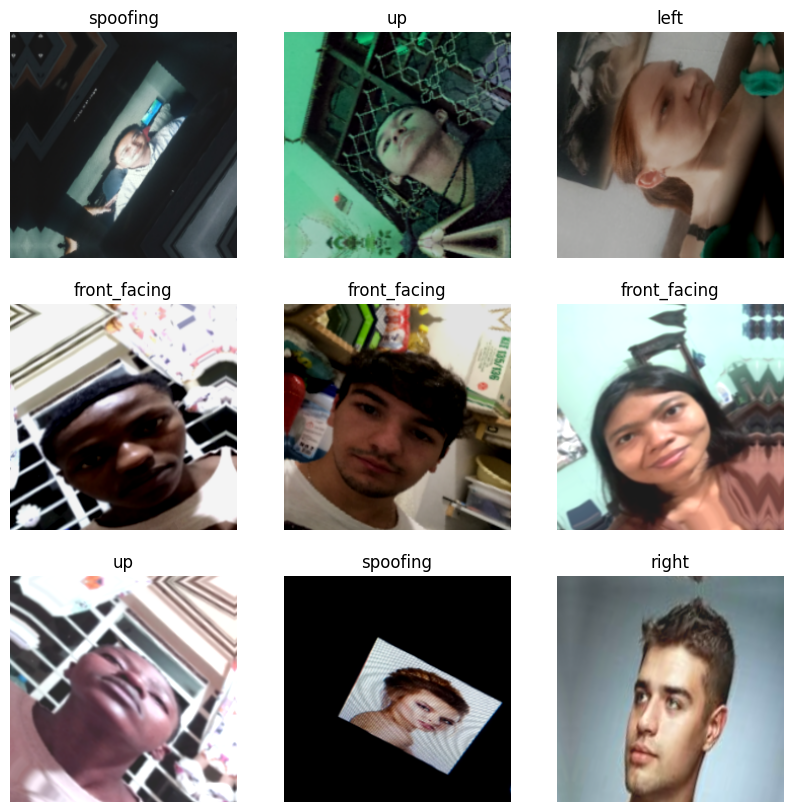

In [48]:

for images, labels in train_dataset.take(1):
    plt.figure(figsize=(10, 10))
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        label_index = tf.argmax(labels[i]).numpy()
        plt.title(train_class_names[label_index])
        plt.axis("off")
    plt.show()

Class names: ['background_train', 'front_facing', 'left', 'right', 'up']


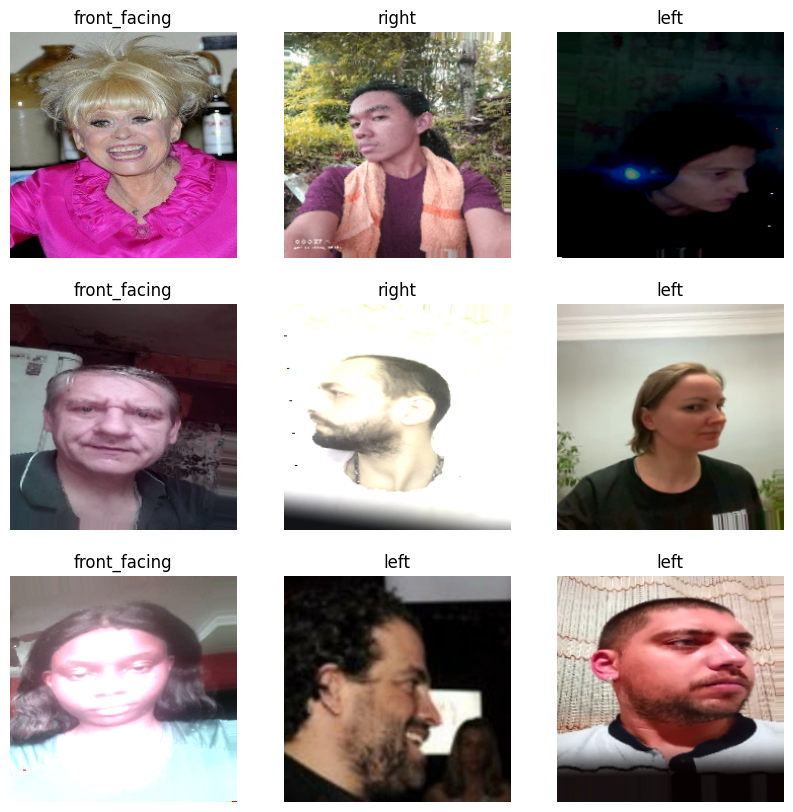

In [ ]:


for images, labels in validation_dataset.take(1):  # Take one batch
    plt.figure(figsize=(10, 10))
    for i in range(9):  # Show first 9 images in the batch
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))  # Convert tensor to uint8 image
        label_index = tf.argmax(labels[i]).numpy()  # Get the index of the highest value in the one-hot array
        plt.title(validation_class_names[label_index])  # Get class name using the index
        plt.axis("off")
    plt.show()

Class names: ['background_test', 'front_facing', 'left', 'right', 'up']


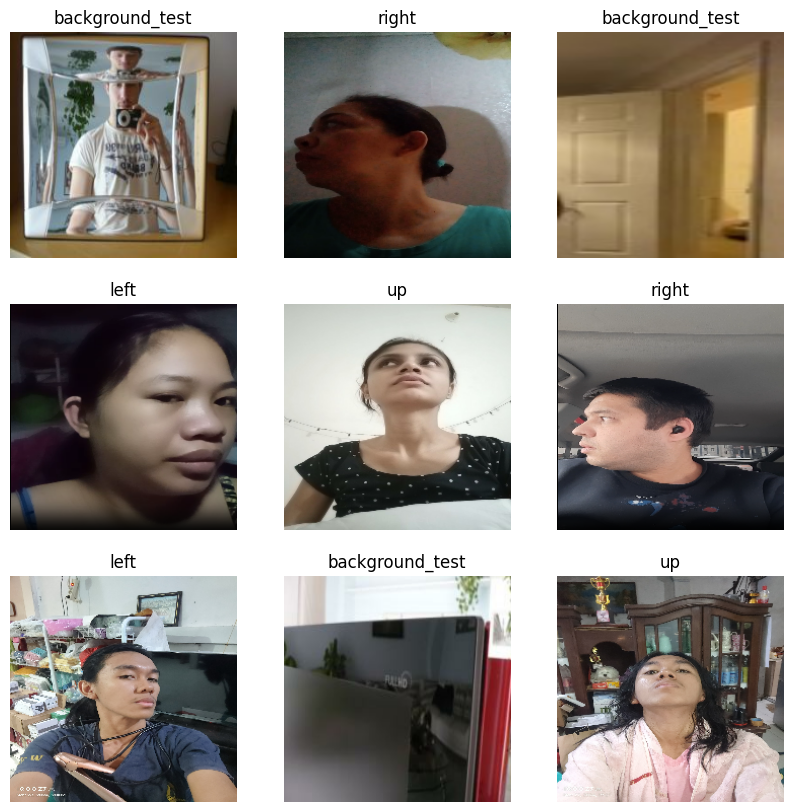

In [ ]:


for images, labels in test_dataset.take(1):  # Take one batch
    plt.figure(figsize=(10, 10))
    for i in range(9):  # Show first 9 images in the batch
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))  # Convert tensor to uint8 image
        label_index = tf.argmax(labels[i]).numpy()  # Get the index of the highest value in the one-hot array
        plt.title(test_class_names[label_index])  # Get class name using the index
        plt.axis("off")
    plt.show()

[1681, 1681, 1681, 1604, 1642]


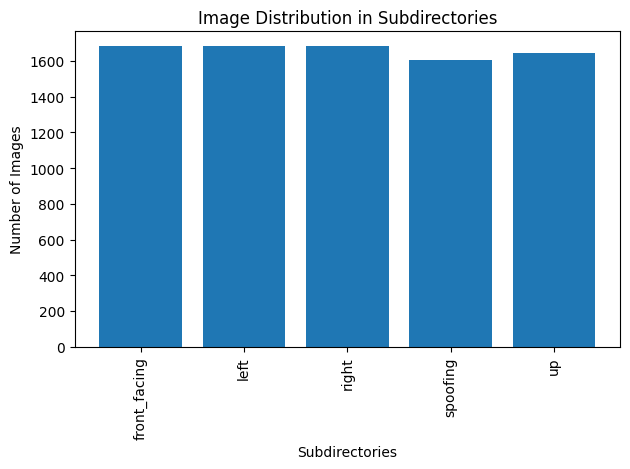

In [49]:

subdirectories = [os.path.join(train_dir, d) for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))]

counts = [len(os.listdir(directory)) for directory in subdirectories]

labels = [os.path.basename(directory) for directory in subdirectories]

print(counts)
plt.bar(labels, counts)
plt.xticks(rotation=90)
plt.ylabel("Number of Images")
plt.xlabel("Subdirectories")
plt.title("Image Distribution in Subdirectories")
plt.tight_layout()
plt.show()

[100, 100, 100, 151, 100]


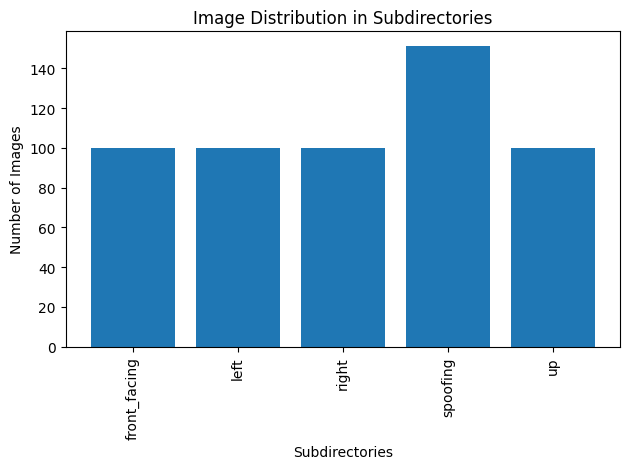

In [50]:

subdirectories = [os.path.join(test_dir, d) for d in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, d))]


counts = [len(os.listdir(directory)) for directory in subdirectories]

labels = [os.path.basename(directory) for directory in subdirectories]

print(counts)

plt.bar(labels, counts)
plt.xticks(rotation=90)
plt.ylabel("Number of Images")
plt.xlabel("Subdirectories")
plt.title("Image Distribution in Subdirectories")
plt.tight_layout()
plt.show()

In [ ]:
# IMAGE_SHAPE = (224, 224, 3)
# MobileNetV3Small(weights='imagenet', include_top=True, input_shape=IMAGE_SHAPE).summary()

In [4]:
IMAGE_SHAPE = (224, 224, 3)
base_model = MobileNetV3Small(weights='imagenet', include_top=False, input_shape=IMAGE_SHAPE)
base_model.summary()

Model: "MobileNetV3Small"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 224, 224,  │          0 │ input_layer_1[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling[0][0]   │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 113, 113,  │          0 │ activation[0][0]  │
│ (ZeroPadding2D)     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 56, 56,    │        144 │ expanded_conv_de… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 56, 56,    │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 56, 56,    │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │          0 │ re_lu[0][0]       │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │        136 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │          0 │ expanded_conv_sq… │
│ (ReLU)              │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │        144 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 1, 1, 16)  │          0 │ expanded_conv_sq… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 1, 1, 16)  │          0 │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply (Multiply) │ (None, 1, 1, 16)  │          0 │ re_lu_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 56, 56,    │          0 │ re_lu[0][0],      │
│ (Multiply)          │ 16)               │            │ multiply[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 56, 56,    │        256 │ expanded_conv_sq

 Total params: 939,120 (3.58 MB)

 Trainable params: 927,008 (3.54 MB)

 Non-trainable params: 12,112 (47.31 KB)

In [ ]:
"""
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomHeight(0.3),
  tf.keras.layers.RandomWidth(0.3),
  tf.keras.layers.RandomBrightness([-0.8,0.8]),
  tf.keras.layers.RandomContrast(0.2)
])
"""

In [5]:
base_model.trainable = False
print(base_model.trainable)
inputs = tf.keras.Input(shape=IMAGE_SHAPE)
# We make sure that the base_model is running in inference mode here,
# by passing `training=False`. This is important for fine-tuning, as you will
# learn in a few paragraphs.
inputs = tf.keras.applications.mobilenet_v3.preprocess_input(inputs)
#inputs = data_augmentation(inputs)
x = base_model(inputs, training=False)
# Convert features of shape `base_model.output_shape[1:]` to vectors
x = tf.keras.layers.GlobalAveragePooling2D()(x)
# A Dense classifier with a single unit (binary classification)
x = tf.keras.layers.Dense(512, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(5, activation='softmax')(x)
model = tf.keras.Model(inputs, outputs)

False


In [ ]:
"""
class F1Score(tf.keras.metrics.Metric):
    def __init__(self, name='f1_score', **kwargs):
        super(F1Score, self).__init__(name=name, **kwargs)
        # Initialize true positives, false positives, and false negatives
        self.true_positives = self.add_weight(name='tp', initializer='zeros')
        self.false_positives = self.add_weight(name='fp', initializer='zeros')
        self.false_negatives = self.add_weight(name='fn', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, tf.bool)
        y_pred = tf.cast(tf.greater(y_pred, 0.5), tf.bool)  # Thresholding for binary classification

        # Update true positives, false positives, and false negatives
        self.true_positives.assign_add(tf.reduce_sum(tf.cast(tf.logical_and(y_true, y_pred), self.dtype)))
        self.false_positives.assign_add(tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not(y_true), y_pred), self.dtype)))
        self.false_negatives.assign_add(tf.reduce_sum(tf.cast(tf.logical_and(y_true, tf.logical_not(y_pred)), self.dtype)))

    def result(self):
        # Calculate precision and recall
        precision = tf.math.divide_no_nan(self.true_positives, self.true_positives + self.false_positives)
        recall = tf.math.divide_no_nan(self.true_positives, self.true_positives + self.false_negatives)

        # Calculate F1 score
        f1 = tf.math.divide_no_nan(2 * precision * recall, precision + recall)
        return f1

    def reset_states(self):
        # Reset the true positives, false positives, and false negatives to zero
        self.true_positives.assign(0)
        self.false_positives.assign(0)
        self.false_negatives.assign(0)

"""

In [6]:
model.compile(optimizer=tf.keras.optimizers.Adam(
                  learning_rate=0.001,
                  beta_1 = 0.9,
                  beta_2 = 0.999,
                  weight_decay = 0.0
                ),
              loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobileNetV3Small (Functional)   │ (None, 7, 7, 576)      │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 576)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │       295,424 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 5)              │         2,565 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,237,109 (4.72 MB)

 Trainable params: 297,989 (1.14 MB)

 Non-trainable params: 939,120 (3.58 MB)

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    min_delta=0.001,
    patience=5,
    restore_best_weights=True
    )

checkpoint = tf.keras.callbacks.ModelCheckpoint(
    "../model_download/all/kedua/liveness_detection.keras",
    monitor="val_accuracy",
    verbose=1,
    save_best_only=True,
    save_weights_only=False,
    mode="max",
    save_freq="epoch",
    )

history = model.fit(train_dataset, epochs=25, batch_size=64, shuffle=500, validation_data=validation_dataset, callbacks=[early_stopping,checkpoint])

# Save model
# model.save('../model_download/latest_model/front_facing/kedua/liveness_detection_model.keras')

Epoch 1/25


I0000 00:00:1733798693.677168   88378 service.cc:148] XLA service 0x7ff790003110 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1733798693.677613   88378 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce RTX 4050 Laptop GPU, Compute Capability 8.9
2024-12-10 09:44:53.810975: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1733798694.436340   88378 cuda_dnn.cc:529] Loaded cuDNN version 90300
2024-12-10 09:44:55.562882: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_3258', 48 bytes spill stores, 48 bytes spill loads

2024-12-10 09:44:55.568722: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_3258

  1/208 ━━━━━━━━━━━━━━━━━━━━ 1:22:03 24s/step - accuracy: 0.1875 - loss: 2.4381 - precision: 0.1500 - recall: 0.0938

I0000 00:00:1733798706.959087   88378 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 17/208 ━━━━━━━━━━━━━━━━━━━━ 3:25 1s/step - accuracy: 0.2987 - loss: 1.7970 - precision: 0.3506 - recall: 0.1429

Invalid SOS parameters for sequential JPEG


 19/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 1s/step - accuracy: 0.3060 - loss: 1.7729 - precision: 0.3626 - recall: 0.1481

Invalid SOS parameters for sequential JPEG


 42/208 ━━━━━━━━━━━━━━━━━━━━ 4:15 2s/step - accuracy: 0.3563 - loss: 1.6158 - precision: 0.4368 - recall: 0.1871

Invalid SOS parameters for sequential JPEG


 43/208 ━━━━━━━━━━━━━━━━━━━━ 4:24 2s/step - accuracy: 0.3579 - loss: 1.6110 - precision: 0.4393 - recall: 0.1884

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:20 2s/step - accuracy: 0.3627 - loss: 1.5971 - precision: 0.4464 - recall: 0.1925

Invalid SOS parameters for sequential JPEG


 50/208 ━━━━━━━━━━━━━━━━━━━━ 4:21 2s/step - accuracy: 0.3685 - loss: 1.5799 - precision: 0.4551 - recall: 0.1974

Invalid SOS parameters for sequential JPEG


 63/208 ━━━━━━━━━━━━━━━━━━━━ 4:12 2s/step - accuracy: 0.3843 - loss: 1.5342 - precision: 0.4788 - recall: 0.2114

Invalid SOS parameters for sequential JPEG


 67/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.3883 - loss: 1.5224 - precision: 0.4847 - recall: 0.2150

Invalid SOS parameters for sequential JPEG


 74/208 ━━━━━━━━━━━━━━━━━━━━ 3:54 2s/step - accuracy: 0.3942 - loss: 1.5037 - precision: 0.4938 - recall: 0.2209

Invalid SOS parameters for sequential JPEG


 78/208 ━━━━━━━━━━━━━━━━━━━━ 3:39 2s/step - accuracy: 0.3971 - loss: 1.4941 - precision: 0.4985 - recall: 0.2238

Invalid SOS parameters for sequential JPEG


 79/208 ━━━━━━━━━━━━━━━━━━━━ 3:43 2s/step - accuracy: 0.3978 - loss: 1.4918 - precision: 0.4996 - recall: 0.2245

Invalid SOS parameters for sequential JPEG


 89/208 ━━━━━━━━━━━━━━━━━━━━ 3:25 2s/step - accuracy: 0.4042 - loss: 1.4709 - precision: 0.5095 - recall: 0.2303

Invalid SOS parameters for sequential JPEG


121/208 ━━━━━━━━━━━━━━━━━━━━ 2:36 2s/step - accuracy: 0.4200 - loss: 1.4188 - precision: 0.5337 - recall: 0.2424

Invalid SOS parameters for sequential JPEG


130/208 ━━━━━━━━━━━━━━━━━━━━ 2:20 2s/step - accuracy: 0.4238 - loss: 1.4066 - precision: 0.5398 - recall: 0.2454

Invalid SOS parameters for sequential JPEG


132/208 ━━━━━━━━━━━━━━━━━━━━ 2:16 2s/step - accuracy: 0.4246 - loss: 1.4040 - precision: 0.5412 - recall: 0.2460

Invalid SOS parameters for sequential JPEG


137/208 ━━━━━━━━━━━━━━━━━━━━ 2:08 2s/step - accuracy: 0.4266 - loss: 1.3978 - precision: 0.5444 - recall: 0.2476

Invalid SOS parameters for sequential JPEG


138/208 ━━━━━━━━━━━━━━━━━━━━ 2:07 2s/step - accuracy: 0.4269 - loss: 1.3966 - precision: 0.5450 - recall: 0.2479

Invalid SOS parameters for sequential JPEG


159/208 ━━━━━━━━━━━━━━━━━━━━ 1:29 2s/step - accuracy: 0.4341 - loss: 1.3737 - precision: 0.5568 - recall: 0.2539

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


181/208 ━━━━━━━━━━━━━━━━━━━━ 50s 2s/step - accuracy: 0.4406 - loss: 1.3533 - precision: 0.5672 - recall: 0.2594

Invalid SOS parameters for sequential JPEG


186/208 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.4419 - loss: 1.3491 - precision: 0.5692 - recall: 0.2605

Invalid SOS parameters for sequential JPEG


201/208 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.4455 - loss: 1.3374 - precision: 0.5750 - recall: 0.2636

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.4469 - loss: 1.3330 - precision: 0.5771 - recall: 0.2648

2024-12-10 09:51:46.798017: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_3258', 268 bytes spill stores, 300 bytes spill loads



208/208 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.4471 - loss: 1.3323 - precision: 0.5775 - recall: 0.2650

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG
2024-12-10 09:53:44.747663: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1361', 12 bytes spill stores, 12 bytes spill loads

2024-12-10 09:53:45.219329: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1361', 152 bytes spill stores, 152 bytes spill loads

2024-12-10 09:53:45.407698: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1361', 48 bytes spill stores, 48 bytes spill loads

2024-12-10 09:53:45.596690: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1361', 568 bytes spill s


Epoch 1: val_accuracy improved from -inf to 0.55703, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 552s 3s/step - accuracy: 0.4473 - loss: 1.3315 - precision: 0.5778 - recall: 0.2652 - val_accuracy: 0.5570 - val_loss: 0.9727 - val_precision: 0.7047 - val_recall: 0.4104
Epoch 2/25


Invalid SOS parameters for sequential JPEG


 11/208 ━━━━━━━━━━━━━━━━━━━━ 5:58 2s/step - accuracy: 0.5304 - loss: 1.0685 - precision: 0.7363 - recall: 0.3575

Invalid SOS parameters for sequential JPEG


 43/208 ━━━━━━━━━━━━━━━━━━━━ 4:53 2s/step - accuracy: 0.5467 - loss: 1.0244 - precision: 0.7220 - recall: 0.3698

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:40 2s/step - accuracy: 0.5473 - loss: 1.0232 - precision: 0.7217 - recall: 0.3707

Invalid SOS parameters for sequential JPEG


 48/208 ━━━━━━━━━━━━━━━━━━━━ 4:36 2s/step - accuracy: 0.5477 - loss: 1.0227 - precision: 0.7213 - recall: 0.3711

Invalid SOS parameters for sequential JPEG


 57/208 ━━━━━━━━━━━━━━━━━━━━ 4:34 2s/step - accuracy: 0.5498 - loss: 1.0188 - precision: 0.7212 - recall: 0.3734

Invalid SOS parameters for sequential JPEG


 62/208 ━━━━━━━━━━━━━━━━━━━━ 4:30 2s/step - accuracy: 0.5509 - loss: 1.0163 - precision: 0.7215 - recall: 0.3750

Invalid SOS parameters for sequential JPEG


 66/208 ━━━━━━━━━━━━━━━━━━━━ 4:26 2s/step - accuracy: 0.5517 - loss: 1.0145 - precision: 0.7216 - recall: 0.3762

Invalid SOS parameters for sequential JPEG


 73/208 ━━━━━━━━━━━━━━━━━━━━ 4:11 2s/step - accuracy: 0.5528 - loss: 1.0118 - precision: 0.7219 - recall: 0.3778

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 79/208 ━━━━━━━━━━━━━━━━━━━━ 3:59 2s/step - accuracy: 0.5536 - loss: 1.0101 - precision: 0.7220 - recall: 0.3790

Invalid SOS parameters for sequential JPEG


 81/208 ━━━━━━━━━━━━━━━━━━━━ 3:58 2s/step - accuracy: 0.5538 - loss: 1.0096 - precision: 0.7219 - recall: 0.3793

Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 2:58 2s/step - accuracy: 0.5549 - loss: 1.0064 - precision: 0.7190 - recall: 0.3817

Invalid SOS parameters for sequential JPEG


111/208 ━━━━━━━━━━━━━━━━━━━━ 3:00 2s/step - accuracy: 0.5549 - loss: 1.0063 - precision: 0.7189 - recall: 0.3818

Invalid SOS parameters for sequential JPEG


131/208 ━━━━━━━━━━━━━━━━━━━━ 2:25 2s/step - accuracy: 0.5556 - loss: 1.0045 - precision: 0.7174 - recall: 0.3832

Invalid SOS parameters for sequential JPEG


134/208 ━━━━━━━━━━━━━━━━━━━━ 2:19 2s/step - accuracy: 0.5557 - loss: 1.0043 - precision: 0.7172 - recall: 0.3834

Invalid SOS parameters for sequential JPEG


140/208 ━━━━━━━━━━━━━━━━━━━━ 2:07 2s/step - accuracy: 0.5558 - loss: 1.0040 - precision: 0.7167 - recall: 0.3835

Invalid SOS parameters for sequential JPEG


153/208 ━━━━━━━━━━━━━━━━━━━━ 1:44 2s/step - accuracy: 0.5557 - loss: 1.0036 - precision: 0.7159 - recall: 0.3838

Invalid SOS parameters for sequential JPEG


183/208 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.5558 - loss: 1.0021 - precision: 0.7150 - recall: 0.3846

Invalid SOS parameters for sequential JPEG


186/208 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.5559 - loss: 1.0019 - precision: 0.7150 - recall: 0.3847

Invalid SOS parameters for sequential JPEG


190/208 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.5559 - loss: 1.0017 - precision: 0.7149 - recall: 0.3849

Invalid SOS parameters for sequential JPEG


194/208 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.5560 - loss: 1.0014 - precision: 0.7149 - recall: 0.3850

Invalid SOS parameters for sequential JPEG


196/208 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.5560 - loss: 1.0013 - precision: 0.7149 - recall: 0.3851

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.5561 - loss: 1.0007 - precision: 0.7147 - recall: 0.3853

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 2: val_accuracy improved from 0.55703 to 0.60169, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 492s 2s/step - accuracy: 0.5561 - loss: 1.0006 - precision: 0.7146 - recall: 0.3854 - val_accuracy: 0.6017 - val_loss: 0.8573 - val_precision: 0.7242 - val_recall: 0.4454
Epoch 3/25
  5/208 ━━━━━━━━━━━━━━━━━━━━ 6:25 2s/step - accuracy: 0.5502 - loss: 0.9431 - precision: 0.7022 - recall: 0.3666

Invalid SOS parameters for sequential JPEG


 23/208 ━━━━━━━━━━━━━━━━━━━━ 5:32 2s/step - accuracy: 0.5626 - loss: 0.9649 - precision: 0.6862 - recall: 0.3832

Invalid SOS parameters for sequential JPEG


 40/208 ━━━━━━━━━━━━━━━━━━━━ 5:06 2s/step - accuracy: 0.5698 - loss: 0.9610 - precision: 0.6903 - recall: 0.3960

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:50 2s/step - accuracy: 0.5720 - loss: 0.9584 - precision: 0.6926 - recall: 0.3990

Invalid SOS parameters for sequential JPEG


 51/208 ━━━━━━━━━━━━━━━━━━━━ 4:37 2s/step - accuracy: 0.5736 - loss: 0.9562 - precision: 0.6947 - recall: 0.4009

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 53/208 ━━━━━━━━━━━━━━━━━━━━ 4:39 2s/step - accuracy: 0.5744 - loss: 0.9551 - precision: 0.6957 - recall: 0.4017

Invalid SOS parameters for sequential JPEG


 68/208 ━━━━━━━━━━━━━━━━━━━━ 4:19 2s/step - accuracy: 0.5788 - loss: 0.9484 - precision: 0.7016 - recall: 0.4072

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 74/208 ━━━━━━━━━━━━━━━━━━━━ 4:06 2s/step - accuracy: 0.5800 - loss: 0.9462 - precision: 0.7034 - recall: 0.4092

Invalid SOS parameters for sequential JPEG


 75/208 ━━━━━━━━━━━━━━━━━━━━ 4:09 2s/step - accuracy: 0.5802 - loss: 0.9459 - precision: 0.7037 - recall: 0.4095

Invalid SOS parameters for sequential JPEG


 79/208 ━━━━━━━━━━━━━━━━━━━━ 4:00 2s/step - accuracy: 0.5810 - loss: 0.9445 - precision: 0.7047 - recall: 0.4108

Invalid SOS parameters for sequential JPEG


108/208 ━━━━━━━━━━━━━━━━━━━━ 3:07 2s/step - accuracy: 0.5850 - loss: 0.9394 - precision: 0.7099 - recall: 0.4178

Invalid SOS parameters for sequential JPEG


126/208 ━━━━━━━━━━━━━━━━━━━━ 2:32 2s/step - accuracy: 0.5870 - loss: 0.9363 - precision: 0.7133 - recall: 0.4215

Invalid SOS parameters for sequential JPEG


135/208 ━━━━━━━━━━━━━━━━━━━━ 2:16 2s/step - accuracy: 0.5880 - loss: 0.9346 - precision: 0.7149 - recall: 0.4231

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


149/208 ━━━━━━━━━━━━━━━━━━━━ 1:48 2s/step - accuracy: 0.5892 - loss: 0.9326 - precision: 0.7168 - recall: 0.4252

Invalid SOS parameters for sequential JPEG


159/208 ━━━━━━━━━━━━━━━━━━━━ 1:32 2s/step - accuracy: 0.5900 - loss: 0.9312 - precision: 0.7181 - recall: 0.4266

Invalid SOS parameters for sequential JPEG


161/208 ━━━━━━━━━━━━━━━━━━━━ 1:28 2s/step - accuracy: 0.5902 - loss: 0.9309 - precision: 0.7184 - recall: 0.4269

Invalid SOS parameters for sequential JPEG


189/208 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.5924 - loss: 0.9269 - precision: 0.7218 - recall: 0.4305

Invalid SOS parameters for sequential JPEG


191/208 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.5925 - loss: 0.9266 - precision: 0.7220 - recall: 0.4307

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


204/208 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.5934 - loss: 0.9250 - precision: 0.7232 - recall: 0.4320

Invalid SOS parameters for sequential JPEG


205/208 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.5934 - loss: 0.9249 - precision: 0.7233 - recall: 0.4321

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.5935 - loss: 0.9247 - precision: 0.7234 - recall: 0.4323

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 3: val_accuracy did not improve from 0.60169
208/208 ━━━━━━━━━━━━━━━━━━━━ 494s 2s/step - accuracy: 0.5936 - loss: 0.9245 - precision: 0.7236 - recall: 0.4324 - val_accuracy: 0.5999 - val_loss: 0.9139 - val_precision: 0.6984 - val_recall: 0.5088
Epoch 4/25


Invalid SOS parameters for sequential JPEG


 26/208 ━━━━━━━━━━━━━━━━━━━━ 5:01 2s/step - accuracy: 0.6194 - loss: 0.9239 - precision: 0.7101 - recall: 0.4583

Invalid SOS parameters for sequential JPEG


 45/208 ━━━━━━━━━━━━━━━━━━━━ 4:52 2s/step - accuracy: 0.6159 - loss: 0.9166 - precision: 0.7128 - recall: 0.4483

Invalid SOS parameters for sequential JPEG


 47/208 ━━━━━━━━━━━━━━━━━━━━ 4:50 2s/step - accuracy: 0.6155 - loss: 0.9159 - precision: 0.7132 - recall: 0.4478

Invalid SOS parameters for sequential JPEG


 49/208 ━━━━━━━━━━━━━━━━━━━━ 4:48 2s/step - accuracy: 0.6152 - loss: 0.9151 - precision: 0.7137 - recall: 0.4475

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 66/208 ━━━━━━━━━━━━━━━━━━━━ 4:22 2s/step - accuracy: 0.6148 - loss: 0.9064 - precision: 0.7189 - recall: 0.4481

Invalid SOS parameters for sequential JPEG


 70/208 ━━━━━━━━━━━━━━━━━━━━ 4:12 2s/step - accuracy: 0.6147 - loss: 0.9048 - precision: 0.7198 - recall: 0.4486

Invalid SOS parameters for sequential JPEG


 72/208 ━━━━━━━━━━━━━━━━━━━━ 4:08 2s/step - accuracy: 0.6147 - loss: 0.9040 - precision: 0.7202 - recall: 0.4488

Invalid SOS parameters for sequential JPEG


 82/208 ━━━━━━━━━━━━━━━━━━━━ 3:54 2s/step - accuracy: 0.6147 - loss: 0.9006 - precision: 0.7220 - recall: 0.4499

Invalid SOS parameters for sequential JPEG


103/208 ━━━━━━━━━━━━━━━━━━━━ 3:16 2s/step - accuracy: 0.6147 - loss: 0.8950 - precision: 0.7249 - recall: 0.4520

Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 3:04 2s/step - accuracy: 0.6148 - loss: 0.8934 - precision: 0.7258 - recall: 0.4527

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


114/208 ━━━━━━━━━━━━━━━━━━━━ 3:00 2s/step - accuracy: 0.6148 - loss: 0.8925 - precision: 0.7262 - recall: 0.4531

Invalid SOS parameters for sequential JPEG


127/208 ━━━━━━━━━━━━━━━━━━━━ 2:36 2s/step - accuracy: 0.6149 - loss: 0.8898 - precision: 0.7274 - recall: 0.4541

Invalid SOS parameters for sequential JPEG


132/208 ━━━━━━━━━━━━━━━━━━━━ 2:25 2s/step - accuracy: 0.6149 - loss: 0.8889 - precision: 0.7278 - recall: 0.4544

Invalid SOS parameters for sequential JPEG


145/208 ━━━━━━━━━━━━━━━━━━━━ 1:59 2s/step - accuracy: 0.6150 - loss: 0.8865 - precision: 0.7290 - recall: 0.4553

Invalid SOS parameters for sequential JPEG


153/208 ━━━━━━━━━━━━━━━━━━━━ 1:44 2s/step - accuracy: 0.6150 - loss: 0.8854 - precision: 0.7296 - recall: 0.4558

Invalid SOS parameters for sequential JPEG


164/208 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.6152 - loss: 0.8838 - precision: 0.7304 - recall: 0.4565

Invalid SOS parameters for sequential JPEG


179/208 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.6155 - loss: 0.8819 - precision: 0.7315 - recall: 0.4574

Invalid SOS parameters for sequential JPEG


194/208 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.6156 - loss: 0.8804 - precision: 0.7323 - recall: 0.4582

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


200/208 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.6157 - loss: 0.8799 - precision: 0.7327 - recall: 0.4585

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6157 - loss: 0.8794 - precision: 0.7330 - recall: 0.4588

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 4: val_accuracy improved from 0.60169 to 0.62281, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 499s 2s/step - accuracy: 0.6157 - loss: 0.8793 - precision: 0.7331 - recall: 0.4589 - val_accuracy: 0.6228 - val_loss: 0.8149 - val_precision: 0.7529 - val_recall: 0.4725
Epoch 5/25
  1/208 ━━━━━━━━━━━━━━━━━━━━ 19:06 6s/step - accuracy: 0.6875 - loss: 0.8731 - precision: 0.8125 - recall: 0.4062

Invalid SOS parameters for sequential JPEG


  9/208 ━━━━━━━━━━━━━━━━━━━━ 5:03 2s/step - accuracy: 0.6343 - loss: 0.8922 - precision: 0.7751 - recall: 0.4196

Invalid SOS parameters for sequential JPEG


 39/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6168 - loss: 0.8852 - precision: 0.7472 - recall: 0.4277

Invalid SOS parameters for sequential JPEG


 41/208 ━━━━━━━━━━━━━━━━━━━━ 4:41 2s/step - accuracy: 0.6164 - loss: 0.8846 - precision: 0.7469 - recall: 0.4285

Invalid SOS parameters for sequential JPEG


 43/208 ━━━━━━━━━━━━━━━━━━━━ 4:43 2s/step - accuracy: 0.6160 - loss: 0.8843 - precision: 0.7464 - recall: 0.4291

Invalid SOS parameters for sequential JPEG


 47/208 ━━━━━━━━━━━━━━━━━━━━ 4:41 2s/step - accuracy: 0.6155 - loss: 0.8830 - precision: 0.7460 - recall: 0.4306

Invalid SOS parameters for sequential JPEG


 55/208 ━━━━━━━━━━━━━━━━━━━━ 4:19 2s/step - accuracy: 0.6148 - loss: 0.8795 - precision: 0.7455 - recall: 0.4336

Invalid SOS parameters for sequential JPEG


 65/208 ━━━━━━━━━━━━━━━━━━━━ 4:15 2s/step - accuracy: 0.6147 - loss: 0.8758 - precision: 0.7455 - recall: 0.4373

Invalid SOS parameters for sequential JPEG


 69/208 ━━━━━━━━━━━━━━━━━━━━ 4:03 2s/step - accuracy: 0.6146 - loss: 0.8745 - precision: 0.7452 - recall: 0.4386

Invalid SOS parameters for sequential JPEG


 71/208 ━━━━━━━━━━━━━━━━━━━━ 4:00 2s/step - accuracy: 0.6145 - loss: 0.8737 - precision: 0.7450 - recall: 0.4393

Invalid SOS parameters for sequential JPEG


 75/208 ━━━━━━━━━━━━━━━━━━━━ 3:52 2s/step - accuracy: 0.6146 - loss: 0.8721 - precision: 0.7449 - recall: 0.4406

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


108/208 ━━━━━━━━━━━━━━━━━━━━ 3:03 2s/step - accuracy: 0.6147 - loss: 0.8633 - precision: 0.7432 - recall: 0.4484

Invalid SOS parameters for sequential JPEG


109/208 ━━━━━━━━━━━━━━━━━━━━ 3:02 2s/step - accuracy: 0.6148 - loss: 0.8631 - precision: 0.7431 - recall: 0.4486

Invalid SOS parameters for sequential JPEG


131/208 ━━━━━━━━━━━━━━━━━━━━ 2:19 2s/step - accuracy: 0.6154 - loss: 0.8594 - precision: 0.7429 - recall: 0.4526

Invalid SOS parameters for sequential JPEG


132/208 ━━━━━━━━━━━━━━━━━━━━ 2:22 2s/step - accuracy: 0.6154 - loss: 0.8593 - precision: 0.7429 - recall: 0.4527

Invalid SOS parameters for sequential JPEG


137/208 ━━━━━━━━━━━━━━━━━━━━ 2:11 2s/step - accuracy: 0.6156 - loss: 0.8587 - precision: 0.7429 - recall: 0.4535

Invalid SOS parameters for sequential JPEG


154/208 ━━━━━━━━━━━━━━━━━━━━ 1:38 2s/step - accuracy: 0.6161 - loss: 0.8569 - precision: 0.7430 - recall: 0.4559

Invalid SOS parameters for sequential JPEG


162/208 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.6163 - loss: 0.8560 - precision: 0.7430 - recall: 0.4569

Invalid SOS parameters for sequential JPEG


183/208 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.6171 - loss: 0.8537 - precision: 0.7434 - recall: 0.4595

Invalid SOS parameters for sequential JPEG


188/208 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.6173 - loss: 0.8532 - precision: 0.7435 - recall: 0.4602

Invalid SOS parameters for sequential JPEG


195/208 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.6175 - loss: 0.8525 - precision: 0.7435 - recall: 0.4609

Invalid SOS parameters for sequential JPEG


204/208 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.6178 - loss: 0.8518 - precision: 0.7435 - recall: 0.4619

Invalid SOS parameters for sequential JPEG


205/208 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.6179 - loss: 0.8517 - precision: 0.7435 - recall: 0.4620

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6179 - loss: 0.8515 - precision: 0.7435 - recall: 0.4622

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 5: val_accuracy improved from 0.62281 to 0.63307, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 488s 2s/step - accuracy: 0.6180 - loss: 0.8514 - precision: 0.7435 - recall: 0.4624 - val_accuracy: 0.6331 - val_loss: 0.8022 - val_precision: 0.7528 - val_recall: 0.5365
Epoch 6/25


Invalid SOS parameters for sequential JPEG


 12/208 ━━━━━━━━━━━━━━━━━━━━ 3:54 1s/step - accuracy: 0.6327 - loss: 0.8077 - precision: 0.7558 - recall: 0.5219

Invalid SOS parameters for sequential JPEG


 42/208 ━━━━━━━━━━━━━━━━━━━━ 4:19 2s/step - accuracy: 0.6319 - loss: 0.8196 - precision: 0.7570 - recall: 0.5089

Invalid SOS parameters for sequential JPEG


 45/208 ━━━━━━━━━━━━━━━━━━━━ 4:16 2s/step - accuracy: 0.6316 - loss: 0.8203 - precision: 0.7565 - recall: 0.5084

Invalid SOS parameters for sequential JPEG


 49/208 ━━━━━━━━━━━━━━━━━━━━ 4:22 2s/step - accuracy: 0.6317 - loss: 0.8205 - precision: 0.7560 - recall: 0.5080

Invalid SOS parameters for sequential JPEG


 57/208 ━━━━━━━━━━━━━━━━━━━━ 4:06 2s/step - accuracy: 0.6321 - loss: 0.8205 - precision: 0.7557 - recall: 0.5077

Invalid SOS parameters for sequential JPEG


 69/208 ━━━━━━━━━━━━━━━━━━━━ 4:04 2s/step - accuracy: 0.6327 - loss: 0.8189 - precision: 0.7554 - recall: 0.5077

Invalid SOS parameters for sequential JPEG


 72/208 ━━━━━━━━━━━━━━━━━━━━ 3:55 2s/step - accuracy: 0.6326 - loss: 0.8189 - precision: 0.7552 - recall: 0.5076

Invalid SOS parameters for sequential JPEG


 76/208 ━━━━━━━━━━━━━━━━━━━━ 3:44 2s/step - accuracy: 0.6325 - loss: 0.8188 - precision: 0.7549 - recall: 0.5075

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 3:49 2s/step - accuracy: 0.6325 - loss: 0.8188 - precision: 0.7548 - recall: 0.5074

Invalid SOS parameters for sequential JPEG


 80/208 ━━━━━━━━━━━━━━━━━━━━ 3:40 2s/step - accuracy: 0.6324 - loss: 0.8189 - precision: 0.7546 - recall: 0.5074

Invalid SOS parameters for sequential JPEG


113/208 ━━━━━━━━━━━━━━━━━━━━ 2:49 2s/step - accuracy: 0.6318 - loss: 0.8191 - precision: 0.7535 - recall: 0.5071

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


128/208 ━━━━━━━━━━━━━━━━━━━━ 2:23 2s/step - accuracy: 0.6317 - loss: 0.8188 - precision: 0.7534 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


131/208 ━━━━━━━━━━━━━━━━━━━━ 2:19 2s/step - accuracy: 0.6317 - loss: 0.8188 - precision: 0.7533 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


138/208 ━━━━━━━━━━━━━━━━━━━━ 2:07 2s/step - accuracy: 0.6316 - loss: 0.8187 - precision: 0.7531 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


160/208 ━━━━━━━━━━━━━━━━━━━━ 1:26 2s/step - accuracy: 0.6313 - loss: 0.8185 - precision: 0.7525 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


167/208 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.6313 - loss: 0.8185 - precision: 0.7522 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


174/208 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.6313 - loss: 0.8184 - precision: 0.7520 - recall: 0.5070

Invalid SOS parameters for sequential JPEG


184/208 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.6313 - loss: 0.8183 - precision: 0.7518 - recall: 0.5068

Invalid SOS parameters for sequential JPEG


193/208 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.6313 - loss: 0.8183 - precision: 0.7516 - recall: 0.5066

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


200/208 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.6313 - loss: 0.8182 - precision: 0.7514 - recall: 0.5065

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6313 - loss: 0.8182 - precision: 0.7513 - recall: 0.5063

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 6: val_accuracy did not improve from 0.63307
208/208 ━━━━━━━━━━━━━━━━━━━━ 484s 2s/step - accuracy: 0.6313 - loss: 0.8182 - precision: 0.7513 - recall: 0.5063 - val_accuracy: 0.6234 - val_loss: 0.8049 - val_precision: 0.7161 - val_recall: 0.5160
Epoch 7/25
 16/208 ━━━━━━━━━━━━━━━━━━━━ 5:19 2s/step - accuracy: 0.6015 - loss: 0.7896 - precision: 0.6934 - recall: 0.4652

Invalid SOS parameters for sequential JPEG


 21/208 ━━━━━━━━━━━━━━━━━━━━ 5:18 2s/step - accuracy: 0.6014 - loss: 0.7964 - precision: 0.6970 - recall: 0.4663

Invalid SOS parameters for sequential JPEG


 42/208 ━━━━━━━━━━━━━━━━━━━━ 4:30 2s/step - accuracy: 0.6034 - loss: 0.8120 - precision: 0.7031 - recall: 0.4726

Invalid SOS parameters for sequential JPEG


 50/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6059 - loss: 0.8138 - precision: 0.7066 - recall: 0.4769

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 51/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6062 - loss: 0.8140 - precision: 0.7071 - recall: 0.4773

Invalid SOS parameters for sequential JPEG


 66/208 ━━━━━━━━━━━━━━━━━━━━ 4:07 2s/step - accuracy: 0.6092 - loss: 0.8144 - precision: 0.7124 - recall: 0.4826

Invalid SOS parameters for sequential JPEG


 68/208 ━━━━━━━━━━━━━━━━━━━━ 4:04 2s/step - accuracy: 0.6096 - loss: 0.8146 - precision: 0.7128 - recall: 0.4831

Invalid SOS parameters for sequential JPEG


 73/208 ━━━━━━━━━━━━━━━━━━━━ 4:01 2s/step - accuracy: 0.6105 - loss: 0.8149 - precision: 0.7141 - recall: 0.4842

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 79/208 ━━━━━━━━━━━━━━━━━━━━ 3:51 2s/step - accuracy: 0.6117 - loss: 0.8146 - precision: 0.7154 - recall: 0.4854

Invalid SOS parameters for sequential JPEG


 82/208 ━━━━━━━━━━━━━━━━━━━━ 3:45 2s/step - accuracy: 0.6123 - loss: 0.8143 - precision: 0.7161 - recall: 0.4859

Invalid SOS parameters for sequential JPEG


115/208 ━━━━━━━━━━━━━━━━━━━━ 2:50 2s/step - accuracy: 0.6167 - loss: 0.8131 - precision: 0.7222 - recall: 0.4903

Invalid SOS parameters for sequential JPEG


117/208 ━━━━━━━━━━━━━━━━━━━━ 2:47 2s/step - accuracy: 0.6170 - loss: 0.8130 - precision: 0.7225 - recall: 0.4905

Invalid SOS parameters for sequential JPEG


130/208 ━━━━━━━━━━━━━━━━━━━━ 2:23 2s/step - accuracy: 0.6183 - loss: 0.8123 - precision: 0.7243 - recall: 0.4918

Invalid SOS parameters for sequential JPEG


137/208 ━━━━━━━━━━━━━━━━━━━━ 2:10 2s/step - accuracy: 0.6187 - loss: 0.8121 - precision: 0.7250 - recall: 0.4922

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


151/208 ━━━━━━━━━━━━━━━━━━━━ 1:45 2s/step - accuracy: 0.6194 - loss: 0.8118 - precision: 0.7260 - recall: 0.4928

Invalid SOS parameters for sequential JPEG


171/208 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.6206 - loss: 0.8108 - precision: 0.7277 - recall: 0.4939

Invalid SOS parameters for sequential JPEG


189/208 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.6217 - loss: 0.8096 - precision: 0.7291 - recall: 0.4951

Invalid SOS parameters for sequential JPEG


193/208 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.6219 - loss: 0.8094 - precision: 0.7294 - recall: 0.4953

Invalid SOS parameters for sequential JPEG


194/208 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.6219 - loss: 0.8093 - precision: 0.7294 - recall: 0.4953

Invalid SOS parameters for sequential JPEG


199/208 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.6222 - loss: 0.8090 - precision: 0.7298 - recall: 0.4956

Invalid SOS parameters for sequential JPEG


206/208 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.6225 - loss: 0.8086 - precision: 0.7303 - recall: 0.4960

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6225 - loss: 0.8085 - precision: 0.7304 - recall: 0.4960

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 7: val_accuracy did not improve from 0.63307
208/208 ━━━━━━━━━━━━━━━━━━━━ 487s 2s/step - accuracy: 0.6226 - loss: 0.8084 - precision: 0.7305 - recall: 0.4961 - val_accuracy: 0.6095 - val_loss: 0.8247 - val_precision: 0.7022 - val_recall: 0.5166
Epoch 8/25


Invalid SOS parameters for sequential JPEG


 14/208 ━━━━━━━━━━━━━━━━━━━━ 5:45 2s/step - accuracy: 0.6456 - loss: 0.7789 - precision: 0.7507 - recall: 0.5550

Invalid SOS parameters for sequential JPEG


 41/208 ━━━━━━━━━━━━━━━━━━━━ 4:41 2s/step - accuracy: 0.6486 - loss: 0.7805 - precision: 0.7440 - recall: 0.5520

Invalid SOS parameters for sequential JPEG


 48/208 ━━━━━━━━━━━━━━━━━━━━ 4:29 2s/step - accuracy: 0.6480 - loss: 0.7800 - precision: 0.7443 - recall: 0.5497

Invalid SOS parameters for sequential JPEG


 49/208 ━━━━━━━━━━━━━━━━━━━━ 4:23 2s/step - accuracy: 0.6480 - loss: 0.7798 - precision: 0.7445 - recall: 0.5494

Invalid SOS parameters for sequential JPEG


 51/208 ━━━━━━━━━━━━━━━━━━━━ 4:17 2s/step - accuracy: 0.6479 - loss: 0.7796 - precision: 0.7447 - recall: 0.5490

Invalid SOS parameters for sequential JPEG


 56/208 ━━━━━━━━━━━━━━━━━━━━ 4:14 2s/step - accuracy: 0.6476 - loss: 0.7795 - precision: 0.7449 - recall: 0.5478

Invalid SOS parameters for sequential JPEG


 70/208 ━━━━━━━━━━━━━━━━━━━━ 4:05 2s/step - accuracy: 0.6476 - loss: 0.7795 - precision: 0.7459 - recall: 0.5447

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 3:51 2s/step - accuracy: 0.6476 - loss: 0.7800 - precision: 0.7462 - recall: 0.5432

Invalid SOS parameters for sequential JPEG


 81/208 ━━━━━━━━━━━━━━━━━━━━ 3:39 2s/step - accuracy: 0.6475 - loss: 0.7803 - precision: 0.7463 - recall: 0.5424

Invalid SOS parameters for sequential JPEG


 95/208 ━━━━━━━━━━━━━━━━━━━━ 3:26 2s/step - accuracy: 0.6474 - loss: 0.7809 - precision: 0.7470 - recall: 0.5402

Invalid SOS parameters for sequential JPEG


117/208 ━━━━━━━━━━━━━━━━━━━━ 2:45 2s/step - accuracy: 0.6480 - loss: 0.7808 - precision: 0.7482 - recall: 0.5381

Invalid SOS parameters for sequential JPEG


127/208 ━━━━━━━━━━━━━━━━━━━━ 2:29 2s/step - accuracy: 0.6480 - loss: 0.7811 - precision: 0.7485 - recall: 0.5373

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


134/208 ━━━━━━━━━━━━━━━━━━━━ 2:15 2s/step - accuracy: 0.6480 - loss: 0.7813 - precision: 0.7486 - recall: 0.5368

Invalid SOS parameters for sequential JPEG


143/208 ━━━━━━━━━━━━━━━━━━━━ 2:00 2s/step - accuracy: 0.6478 - loss: 0.7818 - precision: 0.7486 - recall: 0.5360

Invalid SOS parameters for sequential JPEG


159/208 ━━━━━━━━━━━━━━━━━━━━ 1:30 2s/step - accuracy: 0.6476 - loss: 0.7824 - precision: 0.7485 - recall: 0.5349

Invalid SOS parameters for sequential JPEG


173/208 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.6474 - loss: 0.7826 - precision: 0.7488 - recall: 0.5341

Invalid SOS parameters for sequential JPEG


177/208 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.6473 - loss: 0.7826 - precision: 0.7488 - recall: 0.5339 

Invalid SOS parameters for sequential JPEG


182/208 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.6472 - loss: 0.7826 - precision: 0.7489 - recall: 0.5336

Invalid SOS parameters for sequential JPEG


196/208 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.6472 - loss: 0.7826 - precision: 0.7491 - recall: 0.5330

Invalid SOS parameters for sequential JPEG


197/208 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.6471 - loss: 0.7826 - precision: 0.7491 - recall: 0.5329

Invalid SOS parameters for sequential JPEG


199/208 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.6471 - loss: 0.7826 - precision: 0.7491 - recall: 0.5328

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6471 - loss: 0.7826 - precision: 0.7493 - recall: 0.5325

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 8: val_accuracy improved from 0.63307 to 0.66204, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 490s 2s/step - accuracy: 0.6471 - loss: 0.7826 - precision: 0.7493 - recall: 0.5324 - val_accuracy: 0.6620 - val_loss: 0.7261 - val_precision: 0.7492 - val_recall: 0.5625
Epoch 9/25


Invalid SOS parameters for sequential JPEG


 16/208 ━━━━━━━━━━━━━━━━━━━━ 5:26 2s/step - accuracy: 0.6534 - loss: 0.7273 - precision: 0.7767 - recall: 0.5159

Invalid SOS parameters for sequential JPEG


 44/208 ━━━━━━━━━━━━━━━━━━━━ 4:52 2s/step - accuracy: 0.6480 - loss: 0.7553 - precision: 0.7708 - recall: 0.5134

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:52 2s/step - accuracy: 0.6481 - loss: 0.7556 - precision: 0.7707 - recall: 0.5139

Invalid SOS parameters for sequential JPEG


 55/208 ━━━━━━━━━━━━━━━━━━━━ 4:26 2s/step - accuracy: 0.6480 - loss: 0.7575 - precision: 0.7701 - recall: 0.5158

Invalid SOS parameters for sequential JPEG


 57/208 ━━━━━━━━━━━━━━━━━━━━ 4:24 2s/step - accuracy: 0.6479 - loss: 0.7580 - precision: 0.7698 - recall: 0.5160

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 71/208 ━━━━━━━━━━━━━━━━━━━━ 4:04 2s/step - accuracy: 0.6465 - loss: 0.7618 - precision: 0.7672 - recall: 0.5169

Invalid SOS parameters for sequential JPEG


 74/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.6462 - loss: 0.7626 - precision: 0.7665 - recall: 0.5168

Invalid SOS parameters for sequential JPEG


 75/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.6461 - loss: 0.7629 - precision: 0.7663 - recall: 0.5168

Invalid SOS parameters for sequential JPEG


 78/208 ━━━━━━━━━━━━━━━━━━━━ 3:54 2s/step - accuracy: 0.6458 - loss: 0.7636 - precision: 0.7657 - recall: 0.5168

Invalid SOS parameters for sequential JPEG


 83/208 ━━━━━━━━━━━━━━━━━━━━ 3:49 2s/step - accuracy: 0.6454 - loss: 0.7647 - precision: 0.7648 - recall: 0.5167

Invalid SOS parameters for sequential JPEG


116/208 ━━━━━━━━━━━━━━━━━━━━ 2:50 2s/step - accuracy: 0.6430 - loss: 0.7711 - precision: 0.7595 - recall: 0.5155

Invalid SOS parameters for sequential JPEG


119/208 ━━━━━━━━━━━━━━━━━━━━ 2:47 2s/step - accuracy: 0.6430 - loss: 0.7716 - precision: 0.7592 - recall: 0.5154

Invalid SOS parameters for sequential JPEG


136/208 ━━━━━━━━━━━━━━━━━━━━ 2:13 2s/step - accuracy: 0.6426 - loss: 0.7735 - precision: 0.7573 - recall: 0.5148

Invalid SOS parameters for sequential JPEG


137/208 ━━━━━━━━━━━━━━━━━━━━ 2:15 2s/step - accuracy: 0.6426 - loss: 0.7736 - precision: 0.7572 - recall: 0.5148

Invalid SOS parameters for sequential JPEG


138/208 ━━━━━━━━━━━━━━━━━━━━ 2:13 2s/step - accuracy: 0.6425 - loss: 0.7737 - precision: 0.7571 - recall: 0.5147

Invalid SOS parameters for sequential JPEG


159/208 ━━━━━━━━━━━━━━━━━━━━ 1:31 2s/step - accuracy: 0.6421 - loss: 0.7752 - precision: 0.7557 - recall: 0.5141

Invalid SOS parameters for sequential JPEG


176/208 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.6419 - loss: 0.7755 - precision: 0.7552 - recall: 0.5142

Invalid SOS parameters for sequential JPEG


182/208 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.6419 - loss: 0.7755 - precision: 0.7551 - recall: 0.5143

Invalid SOS parameters for sequential JPEG


186/208 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.6419 - loss: 0.7756 - precision: 0.7550 - recall: 0.5143

Invalid SOS parameters for sequential JPEG


191/208 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.6419 - loss: 0.7757 - precision: 0.7549 - recall: 0.5144

Invalid SOS parameters for sequential JPEG


196/208 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.6419 - loss: 0.7758 - precision: 0.7547 - recall: 0.5145

Invalid SOS parameters for sequential JPEG


198/208 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.6419 - loss: 0.7758 - precision: 0.7547 - recall: 0.5145

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6419 - loss: 0.7760 - precision: 0.7545 - recall: 0.5146

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 9: val_accuracy did not improve from 0.66204
208/208 ━━━━━━━━━━━━━━━━━━━━ 492s 2s/step - accuracy: 0.6419 - loss: 0.7760 - precision: 0.7544 - recall: 0.5146 - val_accuracy: 0.6276 - val_loss: 0.8007 - val_precision: 0.7210 - val_recall: 0.5395
Epoch 10/25


Invalid SOS parameters for sequential JPEG


 17/208 ━━━━━━━━━━━━━━━━━━━━ 6:12 2s/step - accuracy: 0.6980 - loss: 0.7062 - precision: 0.7993 - recall: 0.5665

Invalid SOS parameters for sequential JPEG


 44/208 ━━━━━━━━━━━━━━━━━━━━ 4:56 2s/step - accuracy: 0.6662 - loss: 0.7570 - precision: 0.7613 - recall: 0.5450

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:49 2s/step - accuracy: 0.6651 - loss: 0.7583 - precision: 0.7604 - recall: 0.5442

Invalid SOS parameters for sequential JPEG


 47/208 ━━━━━━━━━━━━━━━━━━━━ 5:11 2s/step - accuracy: 0.6645 - loss: 0.7588 - precision: 0.7600 - recall: 0.5438

Invalid SOS parameters for sequential JPEG


 61/208 ━━━━━━━━━━━━━━━━━━━━ 4:33 2s/step - accuracy: 0.6582 - loss: 0.7647 - precision: 0.7546 - recall: 0.5391

Invalid SOS parameters for sequential JPEG


 65/208 ━━━━━━━━━━━━━━━━━━━━ 4:27 2s/step - accuracy: 0.6570 - loss: 0.7655 - precision: 0.7536 - recall: 0.5378

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 69/208 ━━━━━━━━━━━━━━━━━━━━ 4:23 2s/step - accuracy: 0.6560 - loss: 0.7660 - precision: 0.7528 - recall: 0.5368

Invalid SOS parameters for sequential JPEG


 74/208 ━━━━━━━━━━━━━━━━━━━━ 4:11 2s/step - accuracy: 0.6552 - loss: 0.7664 - precision: 0.7521 - recall: 0.5358

Invalid SOS parameters for sequential JPEG


 76/208 ━━━━━━━━━━━━━━━━━━━━ 4:03 2s/step - accuracy: 0.6548 - loss: 0.7665 - precision: 0.7519 - recall: 0.5355

Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.6547 - loss: 0.7666 - precision: 0.7518 - recall: 0.5354

Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 2:59 2s/step - accuracy: 0.6510 - loss: 0.7680 - precision: 0.7496 - recall: 0.5323

Invalid SOS parameters for sequential JPEG


111/208 ━━━━━━━━━━━━━━━━━━━━ 2:58 2s/step - accuracy: 0.6509 - loss: 0.7680 - precision: 0.7496 - recall: 0.5323

Invalid SOS parameters for sequential JPEG


130/208 ━━━━━━━━━━━━━━━━━━━━ 2:25 2s/step - accuracy: 0.6500 - loss: 0.7676 - precision: 0.7496 - recall: 0.5319

Invalid SOS parameters for sequential JPEG


133/208 ━━━━━━━━━━━━━━━━━━━━ 2:18 2s/step - accuracy: 0.6499 - loss: 0.7675 - precision: 0.7497 - recall: 0.5319

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


159/208 ━━━━━━━━━━━━━━━━━━━━ 1:29 2s/step - accuracy: 0.6498 - loss: 0.7660 - precision: 0.7504 - recall: 0.5321

Invalid SOS parameters for sequential JPEG


167/208 ━━━━━━━━━━━━━━━━━━━━ 1:16 2s/step - accuracy: 0.6498 - loss: 0.7655 - precision: 0.7506 - recall: 0.5322

Invalid SOS parameters for sequential JPEG


174/208 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.6498 - loss: 0.7650 - precision: 0.7508 - recall: 0.5322

Invalid SOS parameters for sequential JPEG


181/208 ━━━━━━━━━━━━━━━━━━━━ 50s 2s/step - accuracy: 0.6498 - loss: 0.7645 - precision: 0.7510 - recall: 0.5323

Invalid SOS parameters for sequential JPEG


192/208 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.6499 - loss: 0.7638 - precision: 0.7512 - recall: 0.5325

Invalid SOS parameters for sequential JPEG


196/208 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.6499 - loss: 0.7636 - precision: 0.7512 - recall: 0.5325

Invalid SOS parameters for sequential JPEG


197/208 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.6499 - loss: 0.7635 - precision: 0.7512 - recall: 0.5326

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6499 - loss: 0.7629 - precision: 0.7514 - recall: 0.5326

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 10: val_accuracy did not improve from 0.66204
208/208 ━━━━━━━━━━━━━━━━━━━━ 489s 2s/step - accuracy: 0.6499 - loss: 0.7628 - precision: 0.7514 - recall: 0.5326 - val_accuracy: 0.6554 - val_loss: 0.7473 - val_precision: 0.7435 - val_recall: 0.5564
Epoch 11/25


Invalid SOS parameters for sequential JPEG


 14/208 ━━━━━━━━━━━━━━━━━━━━ 5:56 2s/step - accuracy: 0.6297 - loss: 0.7363 - precision: 0.7156 - recall: 0.5246

Invalid SOS parameters for sequential JPEG


 44/208 ━━━━━━━━━━━━━━━━━━━━ 4:48 2s/step - accuracy: 0.6429 - loss: 0.7554 - precision: 0.7337 - recall: 0.5298

Invalid SOS parameters for sequential JPEG


 47/208 ━━━━━━━━━━━━━━━━━━━━ 4:52 2s/step - accuracy: 0.6435 - loss: 0.7558 - precision: 0.7344 - recall: 0.5302

Invalid SOS parameters for sequential JPEG


 51/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6442 - loss: 0.7560 - precision: 0.7352 - recall: 0.5308

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 61/208 ━━━━━━━━━━━━━━━━━━━━ 4:29 2s/step - accuracy: 0.6460 - loss: 0.7548 - precision: 0.7374 - recall: 0.5330

Invalid SOS parameters for sequential JPEG


 70/208 ━━━━━━━━━━━━━━━━━━━━ 4:15 2s/step - accuracy: 0.6471 - loss: 0.7538 - precision: 0.7388 - recall: 0.5344

Invalid SOS parameters for sequential JPEG


 72/208 ━━━━━━━━━━━━━━━━━━━━ 4:11 2s/step - accuracy: 0.6473 - loss: 0.7537 - precision: 0.7391 - recall: 0.5345

Invalid SOS parameters for sequential JPEG


 76/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.6475 - loss: 0.7533 - precision: 0.7396 - recall: 0.5347

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 83/208 ━━━━━━━━━━━━━━━━━━━━ 3:47 2s/step - accuracy: 0.6479 - loss: 0.7531 - precision: 0.7401 - recall: 0.5350

Invalid SOS parameters for sequential JPEG


109/208 ━━━━━━━━━━━━━━━━━━━━ 3:02 2s/step - accuracy: 0.6480 - loss: 0.7544 - precision: 0.7409 - recall: 0.5346

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


132/208 ━━━━━━━━━━━━━━━━━━━━ 2:19 2s/step - accuracy: 0.6483 - loss: 0.7544 - precision: 0.7417 - recall: 0.5343

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


134/208 ━━━━━━━━━━━━━━━━━━━━ 2:17 2s/step - accuracy: 0.6483 - loss: 0.7544 - precision: 0.7418 - recall: 0.5342

Invalid SOS parameters for sequential JPEG


150/208 ━━━━━━━━━━━━━━━━━━━━ 1:47 2s/step - accuracy: 0.6483 - loss: 0.7544 - precision: 0.7425 - recall: 0.5339

Invalid SOS parameters for sequential JPEG


165/208 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.6485 - loss: 0.7538 - precision: 0.7433 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


172/208 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.6486 - loss: 0.7534 - precision: 0.7436 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


187/208 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.6487 - loss: 0.7529 - precision: 0.7441 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


191/208 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.6487 - loss: 0.7527 - precision: 0.7443 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


193/208 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.6487 - loss: 0.7527 - precision: 0.7443 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


197/208 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.6487 - loss: 0.7525 - precision: 0.7445 - recall: 0.5338

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6488 - loss: 0.7523 - precision: 0.7448 - recall: 0.5338

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 11: val_accuracy improved from 0.66204 to 0.66385, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 491s 2s/step - accuracy: 0.6488 - loss: 0.7522 - precision: 0.7449 - recall: 0.5338 - val_accuracy: 0.6639 - val_loss: 0.7088 - val_precision: 0.7539 - val_recall: 0.5492
Epoch 12/25
  8/208 ━━━━━━━━━━━━━━━━━━━━ 4:53 1s/step - accuracy: 0.6331 - loss: 0.7224 - precision: 0.7680 - recall: 0.5394

Invalid SOS parameters for sequential JPEG


 16/208 ━━━━━━━━━━━━━━━━━━━━ 4:34 1s/step - accuracy: 0.6520 - loss: 0.7168 - precision: 0.7842 - recall: 0.5459

Invalid SOS parameters for sequential JPEG


 41/208 ━━━━━━━━━━━━━━━━━━━━ 4:32 2s/step - accuracy: 0.6680 - loss: 0.7187 - precision: 0.7870 - recall: 0.5574

Invalid SOS parameters for sequential JPEG


 43/208 ━━━━━━━━━━━━━━━━━━━━ 4:51 2s/step - accuracy: 0.6682 - loss: 0.7187 - precision: 0.7867 - recall: 0.5580

Invalid SOS parameters for sequential JPEG


 47/208 ━━━━━━━━━━━━━━━━━━━━ 4:30 2s/step - accuracy: 0.6689 - loss: 0.7186 - precision: 0.7866 - recall: 0.5593

Invalid SOS parameters for sequential JPEG


 51/208 ━━━━━━━━━━━━━━━━━━━━ 4:24 2s/step - accuracy: 0.6695 - loss: 0.7187 - precision: 0.7864 - recall: 0.5603

Invalid SOS parameters for sequential JPEG


 60/208 ━━━━━━━━━━━━━━━━━━━━ 4:13 2s/step - accuracy: 0.6709 - loss: 0.7180 - precision: 0.7858 - recall: 0.5623

Invalid SOS parameters for sequential JPEG


 74/208 ━━━━━━━━━━━━━━━━━━━━ 3:58 2s/step - accuracy: 0.6712 - loss: 0.7184 - precision: 0.7836 - recall: 0.5636

Invalid SOS parameters for sequential JPEG


 75/208 ━━━━━━━━━━━━━━━━━━━━ 3:54 2s/step - accuracy: 0.6712 - loss: 0.7185 - precision: 0.7835 - recall: 0.5637

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 78/208 ━━━━━━━━━━━━━━━━━━━━ 3:49 2s/step - accuracy: 0.6713 - loss: 0.7186 - precision: 0.7832 - recall: 0.5638

Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 3:00 2s/step - accuracy: 0.6689 - loss: 0.7234 - precision: 0.7781 - recall: 0.5605

Invalid SOS parameters for sequential JPEG


117/208 ━━━━━━━━━━━━━━━━━━━━ 2:52 2s/step - accuracy: 0.6684 - loss: 0.7245 - precision: 0.7773 - recall: 0.5596

Invalid SOS parameters for sequential JPEG


131/208 ━━━━━━━━━━━━━━━━━━━━ 2:24 2s/step - accuracy: 0.6675 - loss: 0.7261 - precision: 0.7757 - recall: 0.5579

Invalid SOS parameters for sequential JPEG


132/208 ━━━━━━━━━━━━━━━━━━━━ 2:23 2s/step - accuracy: 0.6674 - loss: 0.7262 - precision: 0.7756 - recall: 0.5578

Invalid SOS parameters for sequential JPEG


133/208 ━━━━━━━━━━━━━━━━━━━━ 2:20 2s/step - accuracy: 0.6673 - loss: 0.7263 - precision: 0.7754 - recall: 0.5577

Invalid SOS parameters for sequential JPEG


156/208 ━━━━━━━━━━━━━━━━━━━━ 1:39 2s/step - accuracy: 0.6656 - loss: 0.7287 - precision: 0.7725 - recall: 0.5552

Invalid SOS parameters for sequential JPEG


168/208 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.6650 - loss: 0.7295 - precision: 0.7713 - recall: 0.5544

Invalid SOS parameters for sequential JPEG


173/208 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.6648 - loss: 0.7297 - precision: 0.7708 - recall: 0.5541

Invalid SOS parameters for sequential JPEG


181/208 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.6645 - loss: 0.7300 - precision: 0.7700 - recall: 0.5537

Invalid SOS parameters for sequential JPEG


196/208 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.6641 - loss: 0.7303 - precision: 0.7689 - recall: 0.5531

Invalid SOS parameters for sequential JPEG


199/208 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.6640 - loss: 0.7304 - precision: 0.7687 - recall: 0.5530

Invalid SOS parameters for sequential JPEG


202/208 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.6640 - loss: 0.7305 - precision: 0.7685 - recall: 0.5529

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6639 - loss: 0.7306 - precision: 0.7681 - recall: 0.5527

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 12: val_accuracy did not improve from 0.66385
208/208 ━━━━━━━━━━━━━━━━━━━━ 513s 2s/step - accuracy: 0.6638 - loss: 0.7307 - precision: 0.7680 - recall: 0.5526 - val_accuracy: 0.6433 - val_loss: 0.7620 - val_precision: 0.7157 - val_recall: 0.5486
Epoch 13/25
  2/208 ━━━━━━━━━━━━━━━━━━━━ 2:02 596ms/step - accuracy: 0.6719 - loss: 0.6775 - precision: 0.6771 - recall: 0.5234

Invalid SOS parameters for sequential JPEG


 11/208 ━━━━━━━━━━━━━━━━━━━━ 5:11 2s/step - accuracy: 0.6744 - loss: 0.6932 - precision: 0.7341 - recall: 0.5376

Invalid SOS parameters for sequential JPEG


 46/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6731 - loss: 0.7397 - precision: 0.7512 - recall: 0.5430

Invalid SOS parameters for sequential JPEG


 50/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 2s/step - accuracy: 0.6735 - loss: 0.7396 - precision: 0.7521 - recall: 0.5438

Invalid SOS parameters for sequential JPEG


 57/208 ━━━━━━━━━━━━━━━━━━━━ 4:36 2s/step - accuracy: 0.6734 - loss: 0.7396 - precision: 0.7527 - recall: 0.5447

Invalid SOS parameters for sequential JPEG


 60/208 ━━━━━━━━━━━━━━━━━━━━ 4:28 2s/step - accuracy: 0.6733 - loss: 0.7395 - precision: 0.7529 - recall: 0.5450

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 69/208 ━━━━━━━━━━━━━━━━━━━━ 4:22 2s/step - accuracy: 0.6726 - loss: 0.7395 - precision: 0.7530 - recall: 0.5456

Invalid SOS parameters for sequential JPEG


 70/208 ━━━━━━━━━━━━━━━━━━━━ 4:20 2s/step - accuracy: 0.6725 - loss: 0.7395 - precision: 0.7530 - recall: 0.5456

Invalid SOS parameters for sequential JPEG


 72/208 ━━━━━━━━━━━━━━━━━━━━ 4:22 2s/step - accuracy: 0.6723 - loss: 0.7394 - precision: 0.7530 - recall: 0.5458

Invalid SOS parameters for sequential JPEG


 76/208 ━━━━━━━━━━━━━━━━━━━━ 4:08 2s/step - accuracy: 0.6719 - loss: 0.7393 - precision: 0.7530 - recall: 0.5460

Invalid SOS parameters for sequential JPEG


 90/208 ━━━━━━━━━━━━━━━━━━━━ 3:47 2s/step - accuracy: 0.6704 - loss: 0.7394 - precision: 0.7524 - recall: 0.5462

Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 3:03 2s/step - accuracy: 0.6688 - loss: 0.7393 - precision: 0.7519 - recall: 0.5468

Invalid SOS parameters for sequential JPEG


112/208 ━━━━━━━━━━━━━━━━━━━━ 2:59 2s/step - accuracy: 0.6686 - loss: 0.7393 - precision: 0.7518 - recall: 0.5468

Invalid SOS parameters for sequential JPEG


134/208 ━━━━━━━━━━━━━━━━━━━━ 2:22 2s/step - accuracy: 0.6673 - loss: 0.7390 - precision: 0.7517 - recall: 0.5469

Invalid SOS parameters for sequential JPEG


141/208 ━━━━━━━━━━━━━━━━━━━━ 2:09 2s/step - accuracy: 0.6668 - loss: 0.7390 - precision: 0.7516 - recall: 0.5470

Invalid SOS parameters for sequential JPEG


142/208 ━━━━━━━━━━━━━━━━━━━━ 2:07 2s/step - accuracy: 0.6668 - loss: 0.7390 - precision: 0.7516 - recall: 0.5470

Invalid SOS parameters for sequential JPEG


152/208 ━━━━━━━━━━━━━━━━━━━━ 1:48 2s/step - accuracy: 0.6663 - loss: 0.7389 - precision: 0.7516 - recall: 0.5471

Invalid SOS parameters for sequential JPEG


173/208 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.6657 - loss: 0.7384 - precision: 0.7518 - recall: 0.5473

Invalid SOS parameters for sequential JPEG


176/208 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.6656 - loss: 0.7383 - precision: 0.7518 - recall: 0.5474

Invalid SOS parameters for sequential JPEG


189/208 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.6654 - loss: 0.7378 - precision: 0.7521 - recall: 0.5475

Invalid SOS parameters for sequential JPEG


199/208 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.6652 - loss: 0.7374 - precision: 0.7522 - recall: 0.5476

Invalid SOS parameters for sequential JPEG


202/208 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.6651 - loss: 0.7373 - precision: 0.7522 - recall: 0.5477

Invalid SOS parameters for sequential JPEG


205/208 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.6650 - loss: 0.7372 - precision: 0.7523 - recall: 0.5477

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6650 - loss: 0.7372 - precision: 0.7523 - recall: 0.5477

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 13: val_accuracy did not improve from 0.66385
208/208 ━━━━━━━━━━━━━━━━━━━━ 509s 2s/step - accuracy: 0.6649 - loss: 0.7371 - precision: 0.7523 - recall: 0.5477 - val_accuracy: 0.6584 - val_loss: 0.7017 - val_precision: 0.7613 - val_recall: 0.5486
Epoch 14/25
  5/208 ━━━━━━━━━━━━━━━━━━━━ 4:46 1s/step - accuracy: 0.7301 - loss: 0.6170 - precision: 0.8377 - recall: 0.5855

Invalid SOS parameters for sequential JPEG


 11/208 ━━━━━━━━━━━━━━━━━━━━ 5:51 2s/step - accuracy: 0.7163 - loss: 0.6438 - precision: 0.8214 - recall: 0.5921

Invalid SOS parameters for sequential JPEG


 38/208 ━━━━━━━━━━━━━━━━━━━━ 4:57 2s/step - accuracy: 0.6737 - loss: 0.7081 - precision: 0.7885 - recall: 0.5497

Invalid SOS parameters for sequential JPEG


 50/208 ━━━━━━━━━━━━━━━━━━━━ 4:56 2s/step - accuracy: 0.6699 - loss: 0.7151 - precision: 0.7847 - recall: 0.5450

Invalid SOS parameters for sequential JPEG


 56/208 ━━━━━━━━━━━━━━━━━━━━ 4:38 2s/step - accuracy: 0.6688 - loss: 0.7164 - precision: 0.7834 - recall: 0.5440

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 61/208 ━━━━━━━━━━━━━━━━━━━━ 4:30 2s/step - accuracy: 0.6682 - loss: 0.7178 - precision: 0.7823 - recall: 0.5433

Invalid SOS parameters for sequential JPEG


 65/208 ━━━━━━━━━━━━━━━━━━━━ 4:33 2s/step - accuracy: 0.6680 - loss: 0.7182 - precision: 0.7815 - recall: 0.5432

Invalid SOS parameters for sequential JPEG


 69/208 ━━━━━━━━━━━━━━━━━━━━ 4:24 2s/step - accuracy: 0.6679 - loss: 0.7185 - precision: 0.7808 - recall: 0.5432

Invalid SOS parameters for sequential JPEG


 70/208 ━━━━━━━━━━━━━━━━━━━━ 4:27 2s/step - accuracy: 0.6678 - loss: 0.7185 - precision: 0.7805 - recall: 0.5432

Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 4:08 2s/step - accuracy: 0.6677 - loss: 0.7186 - precision: 0.7793 - recall: 0.5433

Invalid SOS parameters for sequential JPEG


 81/208 ━━━━━━━━━━━━━━━━━━━━ 3:57 2s/step - accuracy: 0.6677 - loss: 0.7188 - precision: 0.7787 - recall: 0.5434

Invalid SOS parameters for sequential JPEG


115/208 ━━━━━━━━━━━━━━━━━━━━ 2:57 2s/step - accuracy: 0.6669 - loss: 0.7210 - precision: 0.7746 - recall: 0.5448

Invalid SOS parameters for sequential JPEG


119/208 ━━━━━━━━━━━━━━━━━━━━ 2:52 2s/step - accuracy: 0.6669 - loss: 0.7212 - precision: 0.7742 - recall: 0.5449

Invalid SOS parameters for sequential JPEG


131/208 ━━━━━━━━━━━━━━━━━━━━ 2:28 2s/step - accuracy: 0.6668 - loss: 0.7213 - precision: 0.7733 - recall: 0.5452

Invalid SOS parameters for sequential JPEG


133/208 ━━━━━━━━━━━━━━━━━━━━ 2:25 2s/step - accuracy: 0.6667 - loss: 0.7214 - precision: 0.7731 - recall: 0.5452

Invalid SOS parameters for sequential JPEG


135/208 ━━━━━━━━━━━━━━━━━━━━ 2:23 2s/step - accuracy: 0.6667 - loss: 0.7214 - precision: 0.7729 - recall: 0.5453

Invalid SOS parameters for sequential JPEG


161/208 ━━━━━━━━━━━━━━━━━━━━ 1:31 2s/step - accuracy: 0.6664 - loss: 0.7216 - precision: 0.7710 - recall: 0.5460

Invalid SOS parameters for sequential JPEG


166/208 ━━━━━━━━━━━━━━━━━━━━ 1:22 2s/step - accuracy: 0.6664 - loss: 0.7216 - precision: 0.7707 - recall: 0.5461

Invalid SOS parameters for sequential JPEG


172/208 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.6664 - loss: 0.7214 - precision: 0.7704 - recall: 0.5463

Invalid SOS parameters for sequential JPEG


183/208 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.6666 - loss: 0.7211 - precision: 0.7699 - recall: 0.5468

Invalid SOS parameters for sequential JPEG


195/208 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.6667 - loss: 0.7207 - precision: 0.7693 - recall: 0.5473

Invalid SOS parameters for sequential JPEG


200/208 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.6668 - loss: 0.7206 - precision: 0.7691 - recall: 0.5474

Invalid SOS parameters for sequential JPEG


201/208 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.6668 - loss: 0.7206 - precision: 0.7690 - recall: 0.5475

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6669 - loss: 0.7204 - precision: 0.7688 - recall: 0.5477

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 14: val_accuracy did not improve from 0.66385
208/208 ━━━━━━━━━━━━━━━━━━━━ 513s 2s/step - accuracy: 0.6670 - loss: 0.7203 - precision: 0.7687 - recall: 0.5478 - val_accuracy: 0.6476 - val_loss: 0.7787 - val_precision: 0.7075 - val_recall: 0.5721
Epoch 15/25
  7/208 ━━━━━━━━━━━━━━━━━━━━ 5:47 2s/step - accuracy: 0.6564 - loss: 0.7132 - precision: 0.7271 - recall: 0.5756

Invalid SOS parameters for sequential JPEG


 20/208 ━━━━━━━━━━━━━━━━━━━━ 6:09 2s/step - accuracy: 0.6709 - loss: 0.7133 - precision: 0.7533 - recall: 0.5828

Invalid SOS parameters for sequential JPEG


 41/208 ━━━━━━━━━━━━━━━━━━━━ 5:20 2s/step - accuracy: 0.6727 - loss: 0.7107 - precision: 0.7557 - recall: 0.5745

Invalid SOS parameters for sequential JPEG


 43/208 ━━━━━━━━━━━━━━━━━━━━ 5:16 2s/step - accuracy: 0.6727 - loss: 0.7105 - precision: 0.7557 - recall: 0.5738

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


 54/208 ━━━━━━━━━━━━━━━━━━━━ 4:51 2s/step - accuracy: 0.6722 - loss: 0.7113 - precision: 0.7553 - recall: 0.5702

Invalid SOS parameters for sequential JPEG


 62/208 ━━━━━━━━━━━━━━━━━━━━ 4:45 2s/step - accuracy: 0.6729 - loss: 0.7105 - precision: 0.7560 - recall: 0.5695

Invalid SOS parameters for sequential JPEG


 65/208 ━━━━━━━━━━━━━━━━━━━━ 4:43 2s/step - accuracy: 0.6733 - loss: 0.7100 - precision: 0.7563 - recall: 0.5695

Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 4:11 2s/step - accuracy: 0.6741 - loss: 0.7094 - precision: 0.7569 - recall: 0.5691

Invalid SOS parameters for sequential JPEG


 83/208 ━━━━━━━━━━━━━━━━━━━━ 4:03 2s/step - accuracy: 0.6744 - loss: 0.7094 - precision: 0.7572 - recall: 0.5688

Invalid SOS parameters for sequential JPEG


 91/208 ━━━━━━━━━━━━━━━━━━━━ 3:49 2s/step - accuracy: 0.6743 - loss: 0.7099 - precision: 0.7568 - recall: 0.5681

Invalid SOS parameters for sequential JPEG


118/208 ━━━━━━━━━━━━━━━━━━━━ 2:55 2s/step - accuracy: 0.6735 - loss: 0.7123 - precision: 0.7562 - recall: 0.5663

Invalid SOS parameters for sequential JPEG


126/208 ━━━━━━━━━━━━━━━━━━━━ 2:39 2s/step - accuracy: 0.6732 - loss: 0.7129 - precision: 0.7562 - recall: 0.5658

Invalid SOS parameters for sequential JPEG


133/208 ━━━━━━━━━━━━━━━━━━━━ 2:26 2s/step - accuracy: 0.6728 - loss: 0.7135 - precision: 0.7561 - recall: 0.5653

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


139/208 ━━━━━━━━━━━━━━━━━━━━ 2:13 2s/step - accuracy: 0.6726 - loss: 0.7140 - precision: 0.7561 - recall: 0.5649

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


152/208 ━━━━━━━━━━━━━━━━━━━━ 1:48 2s/step - accuracy: 0.6723 - loss: 0.7148 - precision: 0.7562 - recall: 0.5641

Invalid SOS parameters for sequential JPEG


174/208 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.6718 - loss: 0.7154 - precision: 0.7562 - recall: 0.5632

Invalid SOS parameters for sequential JPEG


180/208 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.6717 - loss: 0.7155 - precision: 0.7562 - recall: 0.5631

Invalid SOS parameters for sequential JPEG


184/208 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.6717 - loss: 0.7155 - precision: 0.7563 - recall: 0.5630

Invalid SOS parameters for sequential JPEG


192/208 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.6717 - loss: 0.7156 - precision: 0.7564 - recall: 0.5629

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


198/208 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.6716 - loss: 0.7155 - precision: 0.7566 - recall: 0.5628

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6716 - loss: 0.7156 - precision: 0.7567 - recall: 0.5627

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 15: val_accuracy improved from 0.66385 to 0.66626, saving model to ../model_download/all/kedua/liveness_detection.keras
208/208 ━━━━━━━━━━━━━━━━━━━━ 511s 2s/step - accuracy: 0.6716 - loss: 0.7156 - precision: 0.7567 - recall: 0.5626 - val_accuracy: 0.6663 - val_loss: 0.7019 - val_precision: 0.7399 - val_recall: 0.5751
Epoch 16/25
  8/208 ━━━━━━━━━━━━━━━━━━━━ 5:39 2s/step - accuracy: 0.7204 - loss: 0.6940 - precision: 0.8473 - recall: 0.6198

Invalid SOS parameters for sequential JPEG


 10/208 ━━━━━━━━━━━━━━━━━━━━ 5:17 2s/step - accuracy: 0.7146 - loss: 0.6894 - precision: 0.8400 - recall: 0.6136

Invalid SOS parameters for sequential JPEG


 40/208 ━━━━━━━━━━━━━━━━━━━━ 4:49 2s/step - accuracy: 0.6789 - loss: 0.6935 - precision: 0.7820 - recall: 0.5834

Invalid SOS parameters for sequential JPEG


 48/208 ━━━━━━━━━━━━━━━━━━━━ 4:42 2s/step - accuracy: 0.6774 - loss: 0.6965 - precision: 0.7775 - recall: 0.5824

Invalid SOS parameters for sequential JPEG


 52/208 ━━━━━━━━━━━━━━━━━━━━ 4:53 2s/step - accuracy: 0.6774 - loss: 0.6966 - precision: 0.7765 - recall: 0.5826

Invalid SOS parameters for sequential JPEG


 55/208 ━━━━━━━━━━━━━━━━━━━━ 4:39 2s/step - accuracy: 0.6775 - loss: 0.6970 - precision: 0.7758 - recall: 0.5827

Invalid SOS parameters for sequential JPEG


 65/208 ━━━━━━━━━━━━━━━━━━━━ 4:15 2s/step - accuracy: 0.6784 - loss: 0.6966 - precision: 0.7743 - recall: 0.5828

Invalid SOS parameters for sequential JPEG


 68/208 ━━━━━━━━━━━━━━━━━━━━ 4:08 2s/step - accuracy: 0.6787 - loss: 0.6962 - precision: 0.7741 - recall: 0.5828

Invalid SOS parameters for sequential JPEG


 73/208 ━━━━━━━━━━━━━━━━━━━━ 3:58 2s/step - accuracy: 0.6791 - loss: 0.6955 - precision: 0.7737 - recall: 0.5827

Invalid SOS parameters for sequential JPEG


 77/208 ━━━━━━━━━━━━━━━━━━━━ 4:02 2s/step - accuracy: 0.6794 - loss: 0.6952 - precision: 0.7733 - recall: 0.5826

Invalid SOS parameters for sequential JPEG


 78/208 ━━━━━━━━━━━━━━━━━━━━ 3:57 2s/step - accuracy: 0.6794 - loss: 0.6951 - precision: 0.7733 - recall: 0.5826

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


110/208 ━━━━━━━━━━━━━━━━━━━━ 2:57 2s/step - accuracy: 0.6798 - loss: 0.6961 - precision: 0.7711 - recall: 0.5817

Invalid SOS parameters for sequential JPEG


111/208 ━━━━━━━━━━━━━━━━━━━━ 2:59 2s/step - accuracy: 0.6798 - loss: 0.6961 - precision: 0.7710 - recall: 0.5817

Invalid SOS parameters for sequential JPEG


136/208 ━━━━━━━━━━━━━━━━━━━━ 2:14 2s/step - accuracy: 0.6800 - loss: 0.6959 - precision: 0.7709 - recall: 0.5813

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG


137/208 ━━━━━━━━━━━━━━━━━━━━ 2:12 2s/step - accuracy: 0.6800 - loss: 0.6959 - precision: 0.7709 - recall: 0.5812

Invalid SOS parameters for sequential JPEG


156/208 ━━━━━━━━━━━━━━━━━━━━ 1:36 2s/step - accuracy: 0.6797 - loss: 0.6958 - precision: 0.7707 - recall: 0.5806

Invalid SOS parameters for sequential JPEG


162/208 ━━━━━━━━━━━━━━━━━━━━ 1:26 2s/step - accuracy: 0.6796 - loss: 0.6956 - precision: 0.7706 - recall: 0.5805

Invalid SOS parameters for sequential JPEG


172/208 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.6795 - loss: 0.6952 - precision: 0.7705 - recall: 0.5804

Invalid SOS parameters for sequential JPEG


182/208 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.6795 - loss: 0.6948 - precision: 0.7704 - recall: 0.5805

Invalid SOS parameters for sequential JPEG


193/208 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.6794 - loss: 0.6944 - precision: 0.7704 - recall: 0.5805

Invalid SOS parameters for sequential JPEG


194/208 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.6794 - loss: 0.6944 - precision: 0.7704 - recall: 0.5805

Invalid SOS parameters for sequential JPEG


197/208 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.6794 - loss: 0.6943 - precision: 0.7704 - recall: 0.5805

Invalid SOS parameters for sequential JPEG


207/208 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.6794 - loss: 0.6940 - precision: 0.7703 - recall: 0.5806

Invalid SOS parameters for sequential JPEG
Invalid SOS parameters for sequential JPEG



Epoch 16: val_accuracy did not improve from 0.66626
208/208 ━━━━━━━━━━━━━━━━━━━━ 491s 2s/step - accuracy: 0.6794 - loss: 0.6940 - precision: 0.7703 - recall: 0.5806 - val_accuracy: 0.6554 - val_loss: 0.7544 - val_precision: 0.7192 - val_recall: 0.5504
Epoch 17/25
  5/208 ━━━━━━━━━━━━━━━━━━━━ 3:48 1s/step - accuracy: 0.7141 - loss: 0.6777 - precision: 0.8582 - recall: 0.6156   

Invalid SOS parameters for sequential JPEG


 21/208 ━━━━━━━━━━━━━━━━━━━━ 5:22 2s/step - accuracy: 0.6905 - loss: 0.6634 - precision: 0.7967 - recall: 0.5967

Invalid SOS parameters for sequential JPEG


 30/208 ━━━━━━━━━━━━━━━━━━━━ 5:00 2s/step - accuracy: 0.6859 - loss: 0.6690 - precision: 0.7871 - recall: 0.5908

KeyboardInterrupt: 

: 

In [ ]:
base_model.trainable = True
for layer in base_model.layers[:-10]:
    layer.trainable = False

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(
                  learning_rate=0.00001,
                  beta_1 = 0.9,
                  beta_2 = 0.999,
                  weight_decay = 0.0
                ),
              loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

In [ ]:
history_fine_tuning = model.fit(train_dataset, epochs=50, batch_size=64, shuffle=500, validation_data=validation_dataset, callbacks=[early_stopping,checkpoint])

In [29]:
# Evaluasi Model
loss, accuracy, precision, recall = model.evaluate(validation_dataset)
print(f"Loss: {loss}, Accuracy: {accuracy}, Precision: {precision}, Recall: {recall}")

8/8 ━━━━━━━━━━━━━━━━━━━━ 10s 791ms/step - accuracy: 0.9067 - loss: 0.2748 - precision_4: 0.9149 - recall_4: 0.9112
Loss: 0.2760752737522125, Accuracy: 0.9125000238418579, Precision: 0.9285714030265808, Recall: 0.9069767594337463


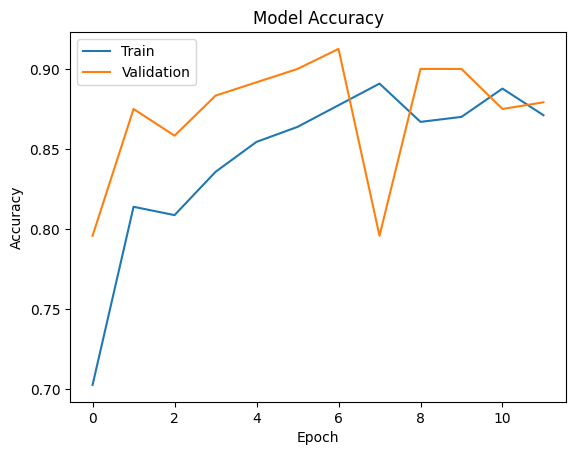

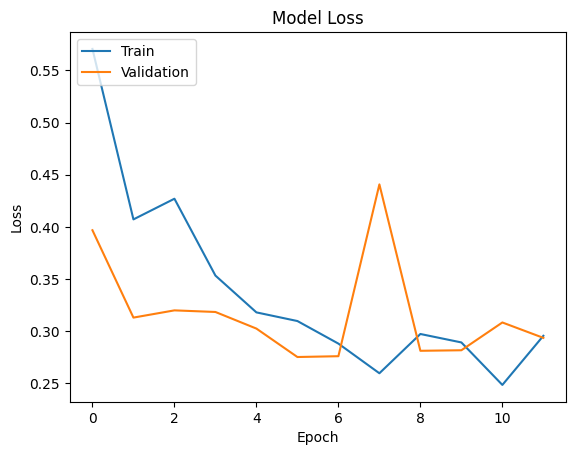

In [30]:
# Plot accuracy dan val_accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot loss dan val_loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [31]:
import logging
logging.getLogger("tensorflow").setLevel(logging.DEBUG)

import tensorflow as tf
from tensorflow import keras
import numpy as np
import pathlib

In [41]:
model = keras.models.load_model('../model_download/all/all_step.keras')

In [42]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

tflite_models_dir = pathlib.Path("../model_download/all")
tflite_models_dir.mkdir(exist_ok=True, parents=True)

tflite_model_file = tflite_models_dir/"all_step.tflite"
tflite_model_file.write_bytes(tflite_model)

converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_types = [tf.float16]

tflite_fp16_model = converter.convert()
tflite_model_fp16_file = tflite_models_dir/"all_model_quant_f16.tflite"
tflite_model_fp16_file.write_bytes(tflite_fp16_model)

INFO:tensorflow:Assets written to: /tmp/tmphq5kz2sd/assets


INFO:tensorflow:Assets written to: /tmp/tmphq5kz2sd/assets


Saved artifact at '/tmp/tmphq5kz2sd'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name='input_layer_3')
Output Type:
  TensorSpec(shape=(None, 6), dtype=tf.float32, name=None)
Captures:
  139986078226864: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078224400: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078230032: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078229504: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078220352: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078234256: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097935584: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097943680: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097941920: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097940336: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13998609794

W0000 00:00:1733771955.977387    1029 tf_tfl_flatbuffer_helpers.cc:365] Ignored output_format.
W0000 00:00:1733771955.978007    1029 tf_tfl_flatbuffer_helpers.cc:368] Ignored drop_control_dependency.
2024-12-10 02:19:15.979196: I tensorflow/cc/saved_model/reader.cc:83] Reading SavedModel from: /tmp/tmphq5kz2sd
2024-12-10 02:19:15.988015: I tensorflow/cc/saved_model/reader.cc:52] Reading meta graph with tags { serve }
2024-12-10 02:19:15.988044: I tensorflow/cc/saved_model/reader.cc:147] Reading SavedModel debug info (if present) from: /tmp/tmphq5kz2sd
2024-12-10 02:19:16.122339: I tensorflow/cc/saved_model/loader.cc:236] Restoring SavedModel bundle.
2024-12-10 02:19:16.750548: I tensorflow/cc/saved_model/loader.cc:220] Running initialization op on SavedModel bundle at path: /tmp/tmphq5kz2sd
2024-12-10 02:19:16.882849: I tensorflow/cc/saved_model/loader.cc:466] SavedModel load for tags { serve }; Status: success: OK. Took 903699 microseconds.


INFO:tensorflow:Assets written to: /tmp/tmp7ns883jo/assets


INFO:tensorflow:Assets written to: /tmp/tmp7ns883jo/assets


Saved artifact at '/tmp/tmp7ns883jo'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name='input_layer_3')
Output Type:
  TensorSpec(shape=(None, 6), dtype=tf.float32, name=None)
Captures:
  139986078226864: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078224400: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078230032: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078229504: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078220352: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986078234256: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097935584: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097943680: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097941920: TensorSpec(shape=(), dtype=tf.resource, name=None)
  139986097940336: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13998609794

W0000 00:00:1733771963.547681    1029 tf_tfl_flatbuffer_helpers.cc:365] Ignored output_format.
W0000 00:00:1733771963.547757    1029 tf_tfl_flatbuffer_helpers.cc:368] Ignored drop_control_dependency.
2024-12-10 02:19:23.547959: I tensorflow/cc/saved_model/reader.cc:83] Reading SavedModel from: /tmp/tmp7ns883jo
2024-12-10 02:19:23.558525: I tensorflow/cc/saved_model/reader.cc:52] Reading meta graph with tags { serve }
2024-12-10 02:19:23.558564: I tensorflow/cc/saved_model/reader.cc:147] Reading SavedModel debug info (if present) from: /tmp/tmp7ns883jo
2024-12-10 02:19:23.655251: I tensorflow/cc/saved_model/loader.cc:236] Restoring SavedModel bundle.
2024-12-10 02:19:27.141832: I tensorflow/cc/saved_model/loader.cc:220] Running initialization op on SavedModel bundle at path: /tmp/tmp7ns883jo
2024-12-10 02:19:27.260356: I tensorflow/cc/saved_model/loader.cc:466] SavedModel load for tags { serve }; Status: success: OK. Took 3712400 microseconds.


7964744

In [17]:
interpreter = tf.lite.Interpreter(model_path=str(tflite_model_file))
interpreter.allocate_tensors()

interpreter_fp16 = tf.lite.Interpreter(model_path=str(tflite_model_fp16_file))
interpreter_fp16.allocate_tensors()

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


ValueError: Cannot set tensor: Dimension mismatch. Got 224 but expected 1 for dimension 1 of input 0.

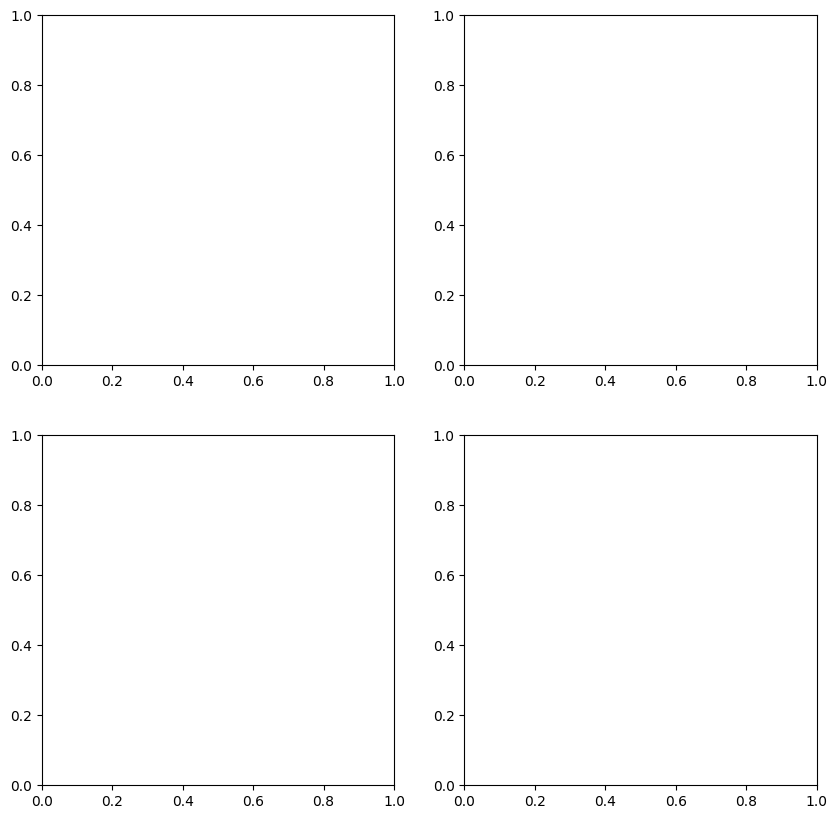

In [43]:
# Fungsi untuk memuat dan memproses gambar
def load_and_preprocess_image(image_path, target_size=(224, 224)):
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0).astype(np.float32)
    return img_array

# Path ke folder gambar
test_images_path = '../datasets/datasets/test_front_facing_set/liveness'
image_files = os.listdir(test_images_path)

# Path ke model TFLite
tflite_model_fp16_file = '../model_download/all/all_model_quant_f16.tflite'

# Memuat model interpreter
interpreter_fp16 = tf.lite.Interpreter(model_path=str(tflite_model_fp16_file))
interpreter_fp16.allocate_tensors()

input_index = interpreter_fp16.get_input_details()[0]["index"]
output_index = interpreter_fp16.get_output_details()[0]["index"]

# Membuat figure untuk subplot
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

# Memilih 4 gambar untuk diuji
for i, image_file in enumerate(image_files[:4]):
    image_path = os.path.join(test_images_path, image_file)
    test_image = load_and_preprocess_image(image_path)

    interpreter_fp16.set_tensor(input_index, test_image)
    interpreter_fp16.invoke()
    predictions = interpreter_fp16.get_tensor(output_index)

    # Menentukan apakah prediksi adalah liveness atau spoofing
    predicted_class = np.argmax(predictions[0])
    label = "liveness" if predicted_class == 1 else "spoofing"
    score = predictions[0][predicted_class]

    # Menentukan posisi subplot
    ax = axes[i // 2, i % 2]
    ax.imshow(load_img(image_path))
    template = "Predicted: {predict} ({label})\nScore: {score}"
    ax.set_title(template.format(predict=str(predicted_class), label=label, score=score))
    ax.grid(False)
    ax.axis('off')

plt.tight_layout()
plt.show()

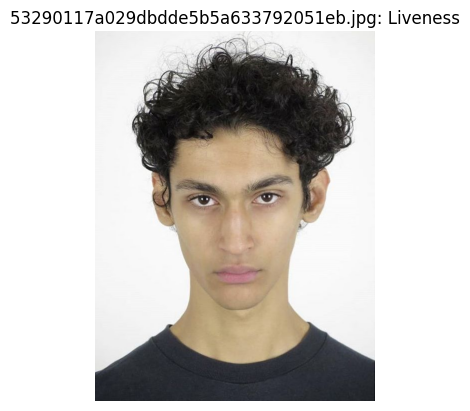

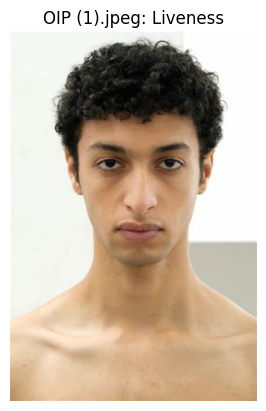

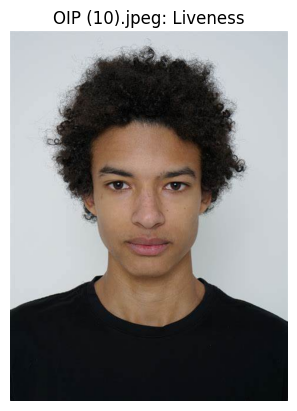

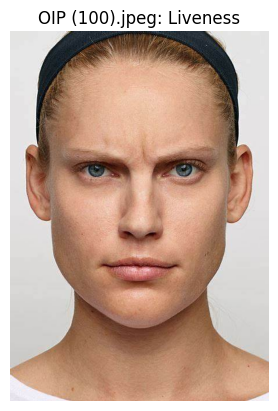

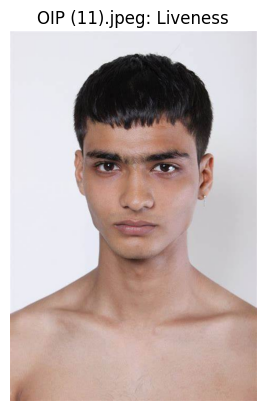

...

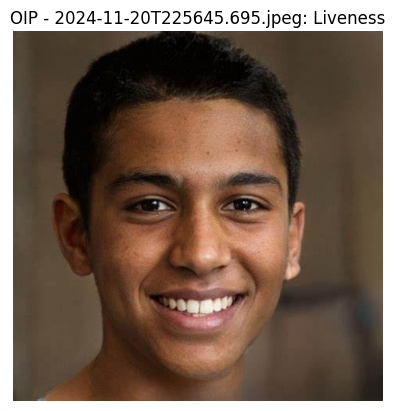

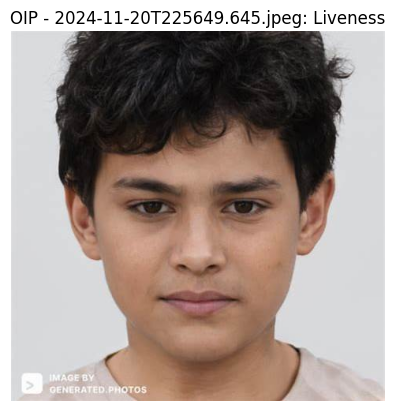

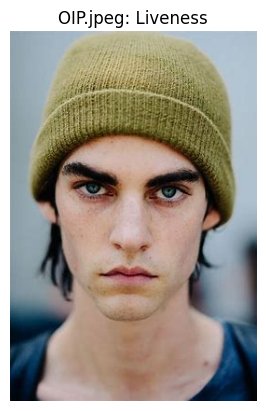

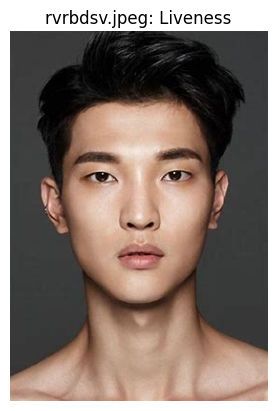

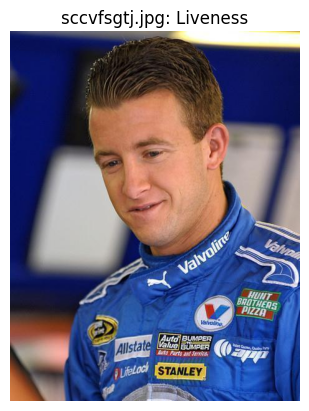

KeyboardInterrupt: 

In [39]:
import tensorflow as tf
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt

# Load the quantized model
interpreter = tf.lite.Interpreter(model_path="../model_download/latest_model/front_facing/kedua/liveness_detection_model_quant_f16.tflite")
interpreter.allocate_tensors()

# Get input and output details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

def preprocess_image(image_path):
    """
    Preprocess the input image to the required format
    """
    image = cv2.imread(image_path)
    image = cv2.resize(image, (224, 224))  # Resize to the input size of the model
    image = image.astype(np.float32) / 255.0  # Normalize the image
    image = np.expand_dims(image, axis=0)  # Add batch dimension
    return image

def predict(image_path):
    """
    Predict the class of the input image
    """
    image = preprocess_image(image_path)
    
    # Set the tensor to point to the input data to be inferred
    interpreter.set_tensor(input_details[0]['index'], image)
    
    # Run inference
    interpreter.invoke()
    
    # Get the output tensor
    output_data = interpreter.get_tensor(output_details[0]['index'])
    
    # Apply sigmoid activation
    prediction = tf.nn.sigmoid(output_data).numpy()
    
    # Determine the class
    if prediction >= 0.5:
        return "Liveness"
    else:
        return "Spoofing"

def predict_and_plot(directory):
    """
    Predict the class of all images in the directory and plot them
    """
    for filename in os.listdir(directory):
        if filename.lower().endswith((".jpg", ".jpeg", ".png")):
            image_path = os.path.join(directory, filename)
            result = predict(image_path)
            
            # Load the image for plotting
            image = cv2.imread(image_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib
            
            # Plot the image with the prediction
            plt.figure()
            plt.imshow(image)
            plt.title(f"{filename}: {result}")
            plt.axis('off')
            plt.show()

# Example usage
directory = "../datasets/datasets/test_front_facing_set/liveness"
predict_and_plot(directory)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


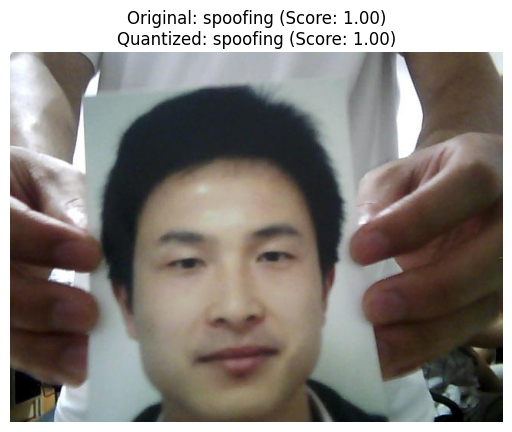

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


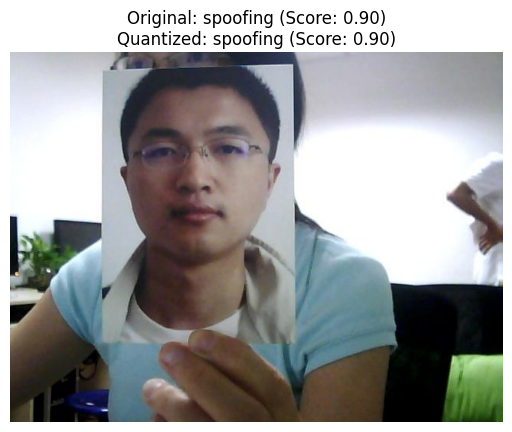

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


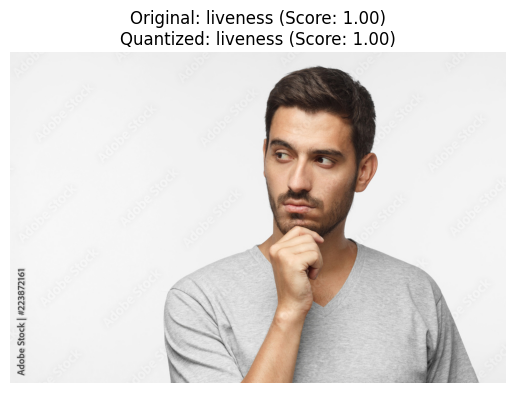

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


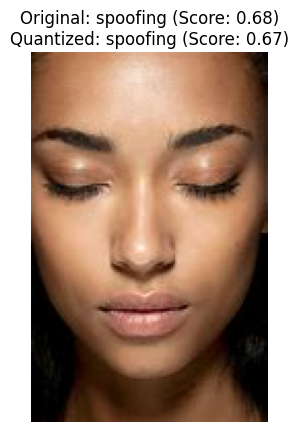

In [34]:
# Fungsi untuk memuat dan memproses gambar
def load_and_preprocess_image(image_path, target_size=(224, 224)):
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0).astype(np.float32)
    return img_array

# Path ke folder gambar
test_images_path = '../datasets/test/test'
image_files = os.listdir(test_images_path)

# Path ke model asli dan model kuantisasi
original_model_path = '../model_download/latest_model/front_facing/front_facing_model2.keras'
quantized_model_path = '../model_download/latest_model/front_facing/front_facing_model_quant_f16_2_metadata.tflite'

# Memuat model asli
original_model = tf.keras.models.load_model(original_model_path)

# Memuat model kuantisasi
quantized_interpreter = tf.lite.Interpreter(model_path=quantized_model_path)
quantized_interpreter.allocate_tensors()

input_index = quantized_interpreter.get_input_details()[0]["index"]
output_index = quantized_interpreter.get_output_details()[0]["index"]

# Fungsi untuk melakukan inferensi menggunakan model kuantisasi
def infer_quantized_model(interpreter, input_data):
    interpreter.set_tensor(input_index, input_data)
    interpreter.invoke()
    return interpreter.get_tensor(output_index)

# Memilih 4 gambar untuk diuji
for i, image_file in enumerate(image_files[:4]):
    image_path = os.path.join(test_images_path, image_file)
    test_image = load_and_preprocess_image(image_path)

    # Inferensi menggunakan model asli
    original_predictions = original_model.predict(test_image)

    # Inferensi menggunakan model kuantisasi
    quantized_predictions = infer_quantized_model(quantized_interpreter, test_image)

    # Menentukan apakah prediksi adalah liveness atau spoofing
    original_class = np.argmax(original_predictions[0])
    quantized_class = np.argmax(quantized_predictions[0])
    original_label = "liveness" if original_class == 1 else "spoofing"
    quantized_label = "liveness" if quantized_class == 1 else "spoofing"
    original_score = original_predictions[0][original_class]
    quantized_score = quantized_predictions[0][quantized_class]

    # Menampilkan hasil
    plt.figure()
    plt.imshow(load_img(image_path))
    template = "Original: {orig_label} (Score: {orig_score:.2f})\nQuantized: {quant_label} (Score: {quant_score:.2f})"
    plt.title(template.format(orig_label=original_label, orig_score=original_score,
                              quant_label=quantized_label, quant_score=quantized_score))
    plt.grid(False)
    plt.axis('off')
    plt.show()